In [22]:
from google.colab import drive
from tensorflow.keras.preprocessing.image import ImageDataGenerator , load_img
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D,Flatten,Dense,MaxPool2D,BatchNormalization

import matplotlib.pyplot as plt
import numpy as np

from tensorflow.keras.models import model_from_json
from tensorflow.keras import Model as model

In [3]:
drive.mount('/content/drive')

Mounted at /content/drive


In [40]:
import os

In [24]:
os.listdir()

['.config', 'drive', 'sample_data']

In [ ]:
!unzip '/content/drive/My Drive/fruits_database/fruit.zip' -d '/content/drive/My Drive/fruits_database'

Streaming output truncated to the last 5000 lines.
  inflating: /content/drive/My Drive/fruits_database/fruits-360_dataset/fruits-360/Training/Tomato 3/111_100.jpg  
  inflating: /content/drive/My Drive/fruits_database/fruits-360_dataset/fruits-360/Training/Tomato 3/112_100.jpg  
  inflating: /content/drive/My Drive/fruits_database/fruits-360_dataset/fruits-360/Training/Tomato 3/113_100.jpg  
  inflating: /content/drive/My Drive/fruits_database/fruits-360_dataset/fruits-360/Training/Tomato 3/114_100.jpg  
  inflating: /content/drive/My Drive/fruits_database/fruits-360_dataset/fruits-360/Training/Tomato 3/115_100.jpg  
  inflating: /content/drive/My Drive/fruits_database/fruits-360_dataset/fruits-360/Training/Tomato 3/116_100.jpg  
  inflating: /content/drive/My Drive/fruits_database/fruits-360_dataset/fruits-360/Training/Tomato 3/117_100.jpg  
  inflating: /content/drive/My Drive/fruits_database/fruits-360_dataset/fruits-360/Training/Tomato 3/119_100.jpg  
  inflating: /content/drive/M

In [25]:
labeling_job = ImageDataGenerator(rescale=1./255)

In [26]:
training_label = labeling_job.flow_from_directory('/content/drive/My Drive/fruits_database/fruits-360_dataset/fruits-360/Training',target_size=(260,260),batch_size=32)
testing_label = labeling_job.flow_from_directory('/content/drive/My Drive/fruits_database/fruits-360_dataset/fruits-360/Test',target_size=(260,260),batch_size=32,classes=training_label.class_indices)
valid_label = labeling_job.flow_from_directory('/content/drive/My Drive/fruits_database/fruits-360_dataset/fruits-360/Validation',target_size=(260,260),batch_size=32,classes=training_label.class_indices)

Found 18009 images belonging to 88 classes.
Found 14892 images belonging to 88 classes.
Found 0 images belonging to 88 classes.


In [27]:
model = Sequential()

model.add(Conv2D(32,(3,3),input_shape=(260,260,3)))
model.add(MaxPool2D((3,3)))

for i in range(6,9):
  model.add(Conv2D(2**i,(3,3)))
  model.add(MaxPool2D((3,3)))

model.add(MaxPool2D((2,2)))
model.add(Flatten())

model.add(Dense(training_label.num_classes,activation='softmax'))

In [9]:
training_label.num_classes

88

In [28]:
model.compile(optimizer='adam',loss='categorical_crossentropy',metrics=['accuracy'])

In [29]:
model.fit(training_label,epochs=2,validation_data=valid_label)

Epoch 1/2
563/563 [==============================] - 816s 1s/step - loss: 0.3490 - accuracy: 0.9050
Epoch 2/2
563/563 [==============================] - 811s 1s/step - loss: 0.0849 - accuracy: 0.9789


In [30]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_4 (Conv2D)            (None, 258, 258, 32)      896       
_________________________________________________________________
max_pooling2d_5 (MaxPooling2 (None, 86, 86, 32)        0         
_________________________________________________________________
conv2d_5 (Conv2D)            (None, 84, 84, 64)        18496     
_________________________________________________________________
max_pooling2d_6 (MaxPooling2 (None, 28, 28, 64)        0         
_________________________________________________________________
conv2d_6 (Conv2D)            (None, 26, 26, 128)       73856     
_________________________________________________________________
max_pooling2d_7 (MaxPooling2 (None, 8, 8, 128)         0         
_________________________________________________________________
conv2d_7 (Conv2D)            (None, 6, 6, 256)        

Correct class for image Apple Braeburn 
Predicted class for image Apple Red Yellow 1 


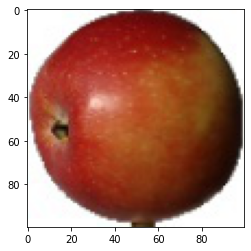

Correct class for image Apple Braeburn 
Predicted class for image Apple Red Yellow 1 


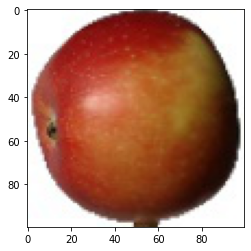

Correct class for image Apple Braeburn 
Predicted class for image Apple Red Yellow 1 


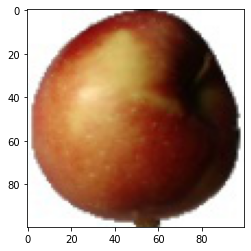

Correct class for image Apple Braeburn 
Predicted class for image Apple Red Yellow 1 


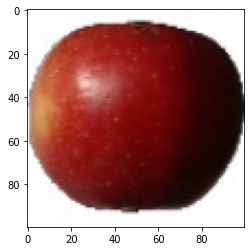

Correct class for image Apple Crimson Snow 
Predicted class for image Apple Red Yellow 1 


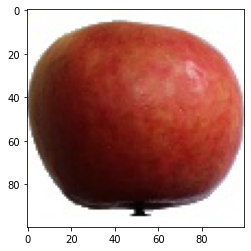

Correct class for image Apple Crimson Snow 
Predicted class for image Apple Red Yellow 1 


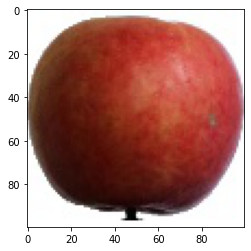

Correct class for image Apple Crimson Snow 
Predicted class for image Apple Red Yellow 1 


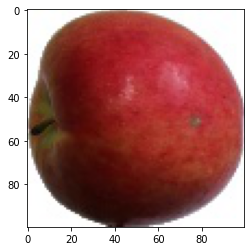

Correct class for image Apple Crimson Snow 
Predicted class for image Apple Red Yellow 1 


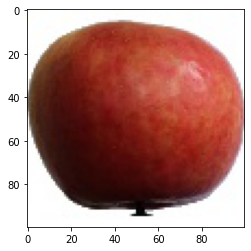

Correct class for image Apple Golden 1 
Predicted class for image Cantaloupe 1 


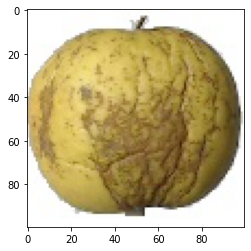

Correct class for image Apple Golden 1 
Predicted class for image Cantaloupe 1 


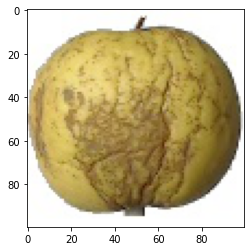

Correct class for image Apple Golden 1 
Predicted class for image Cantaloupe 1 


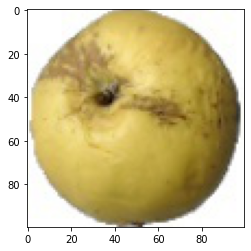

Correct class for image Apple Golden 1 
Predicted class for image Cantaloupe 1 


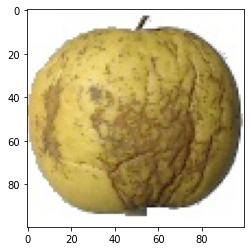

Correct class for image Apple Golden 2 
Predicted class for image Cantaloupe 1 


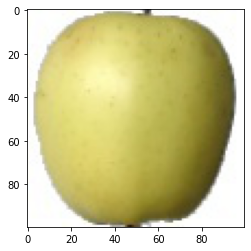

Correct class for image Apple Golden 2 
Predicted class for image Cantaloupe 1 


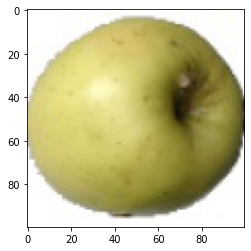

Correct class for image Apple Golden 2 
Predicted class for image Cantaloupe 1 


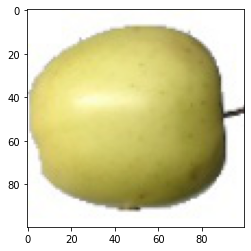

Correct class for image Apple Golden 2 
Predicted class for image Cantaloupe 1 


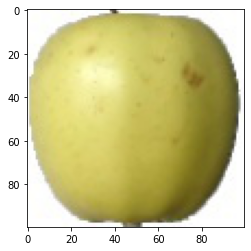

Correct class for image Apple Golden 3 
Predicted class for image Apple Golden 1 


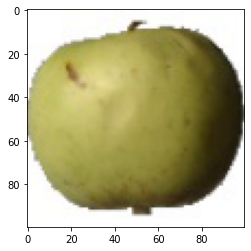

Correct class for image Apple Golden 3 
Predicted class for image Apple Golden 1 


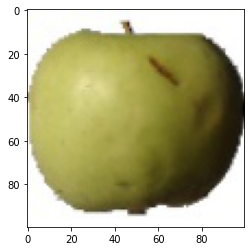

Correct class for image Apple Golden 3 
Predicted class for image Apple Red Yellow 1 


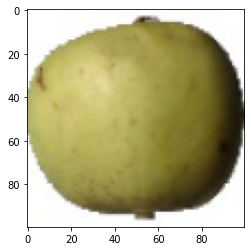

Correct class for image Apple Golden 3 
Predicted class for image Apple Golden 1 


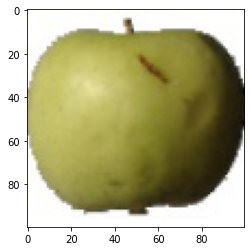

Correct class for image Apple Granny Smith 
Predicted class for image Apple Golden 1 


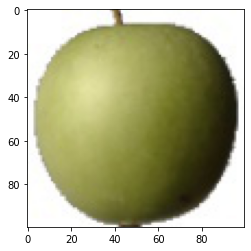

Correct class for image Apple Granny Smith 
Predicted class for image Carambula 


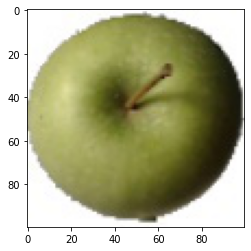

Correct class for image Apple Granny Smith 
Predicted class for image Carambula 


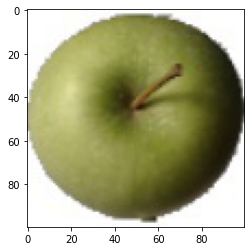

Correct class for image Apple Granny Smith 
Predicted class for image Apple Golden 1 


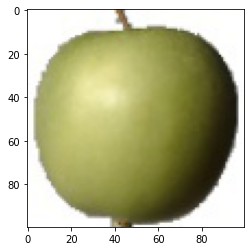

Correct class for image Apple Pink Lady 
Predicted class for image Cherry Wax Yellow 


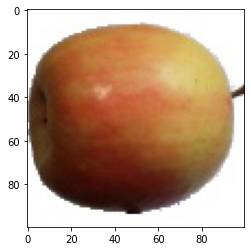

Correct class for image Apple Pink Lady 
Predicted class for image Cherry Wax Yellow 


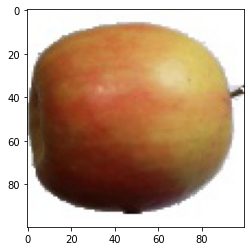

Correct class for image Apple Pink Lady 
Predicted class for image Cherry Wax Yellow 


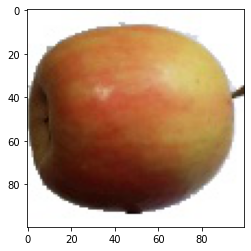

Correct class for image Apple Pink Lady 
Predicted class for image Apple Pink Lady 


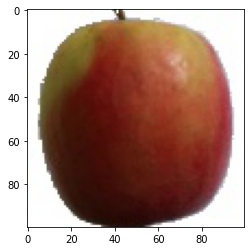

Correct class for image Apple Red 1 
Predicted class for image Apple Red Yellow 1 


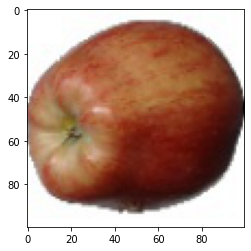

Correct class for image Apple Red 1 
Predicted class for image Apple Red Yellow 1 


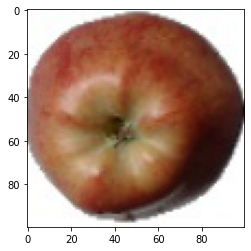

Correct class for image Apple Red 1 
Predicted class for image Apple Red Yellow 1 


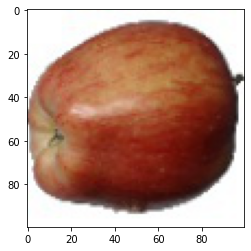

Correct class for image Apple Red 1 
Predicted class for image Apple Red Yellow 1 


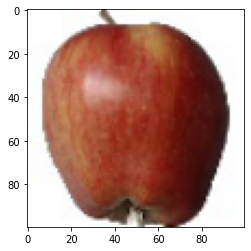

Correct class for image Apple Red 2 
Predicted class for image Apple Red Yellow 1 


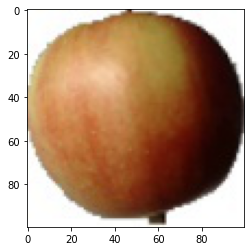

Correct class for image Apple Red 2 
Predicted class for image Apple Red Yellow 1 


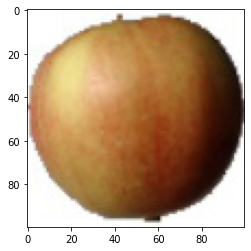

Correct class for image Apple Red 2 
Predicted class for image Apple Red Yellow 1 


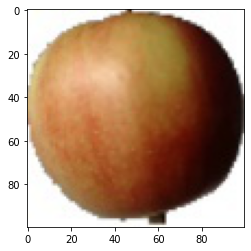

Correct class for image Apple Red 2 
Predicted class for image Apple Red Yellow 1 


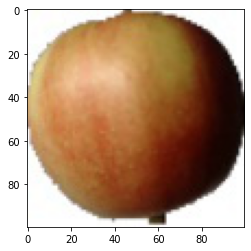

Correct class for image Apple Red 3 
Predicted class for image Apple Red Yellow 1 


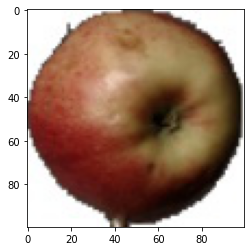

Correct class for image Apple Red 3 
Predicted class for image Apple Red Yellow 1 


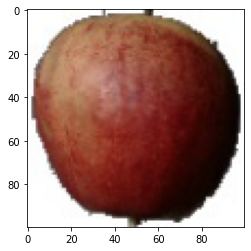

Correct class for image Apple Red 3 
Predicted class for image Apple Red Yellow 1 


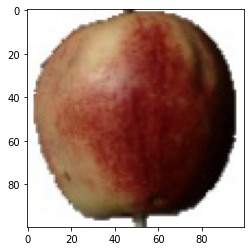

Correct class for image Apple Red 3 
Predicted class for image Apple Red Yellow 1 


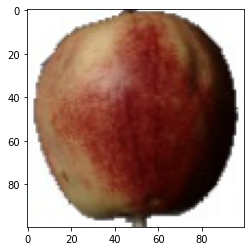

Correct class for image Apple Red Delicious 
Predicted class for image Cherry Rainier 


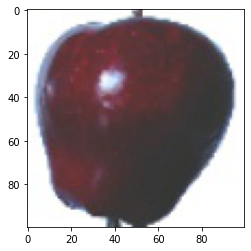

Correct class for image Apple Red Delicious 
Predicted class for image Cherry Rainier 


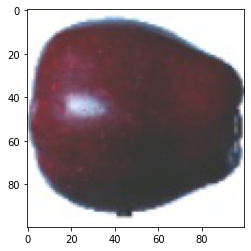

Correct class for image Apple Red Delicious 
Predicted class for image Cherry Rainier 


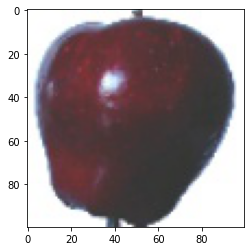

Correct class for image Apple Red Delicious 
Predicted class for image Cherry Rainier 


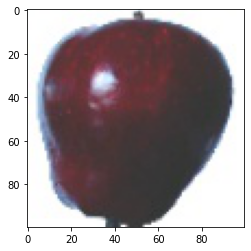

Correct class for image Apple Red Yellow 1 
Predicted class for image Apple Red Yellow 1 


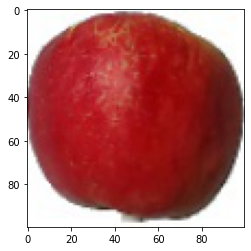

Correct class for image Apple Red Yellow 1 
Predicted class for image Apple Red Yellow 1 


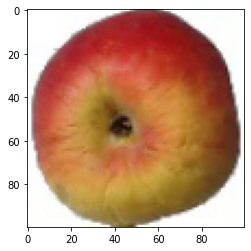

Correct class for image Apple Red Yellow 1 
Predicted class for image Apple Red Yellow 1 


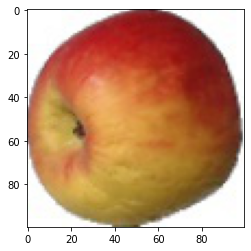

Correct class for image Apple Red Yellow 1 
Predicted class for image Apple Red Yellow 1 


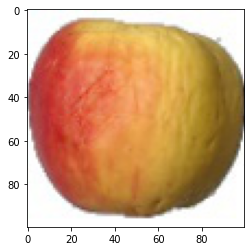

Correct class for image Apple Red Yellow 2 
Predicted class for image Carambula 


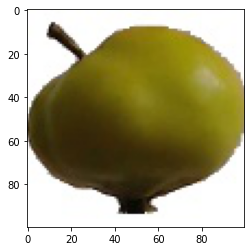

Correct class for image Apple Red Yellow 2 
Predicted class for image Carambula 


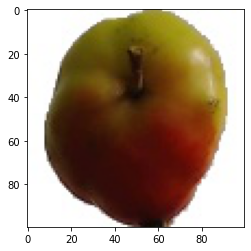

Correct class for image Apple Red Yellow 2 
Predicted class for image Carambula 


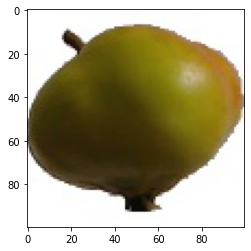

Correct class for image Apple Red Yellow 2 
Predicted class for image Carambula 


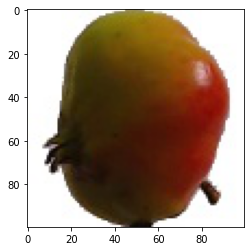

Correct class for image Apricot 
Predicted class for image Clementine 


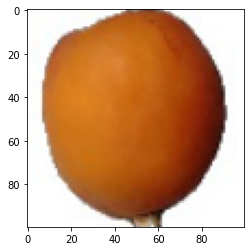

Correct class for image Apricot 
Predicted class for image Clementine 


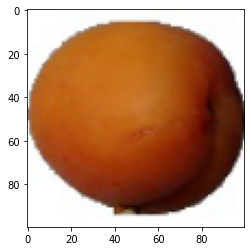

Correct class for image Apricot 
Predicted class for image Clementine 


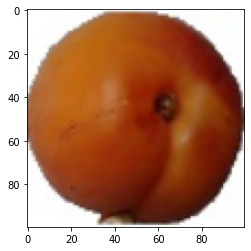

Correct class for image Apricot 
Predicted class for image Clementine 


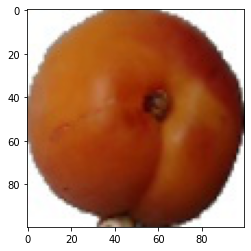

Correct class for image Avocado ripe 
Predicted class for image Cantaloupe 2 


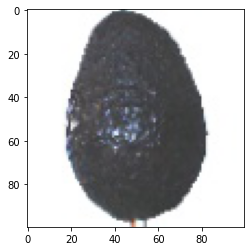

Correct class for image Avocado ripe 
Predicted class for image Cantaloupe 2 


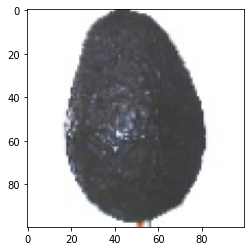

Correct class for image Avocado ripe 
Predicted class for image Cantaloupe 2 


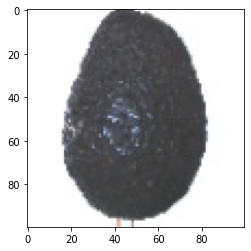

Correct class for image Avocado ripe 
Predicted class for image Cantaloupe 2 


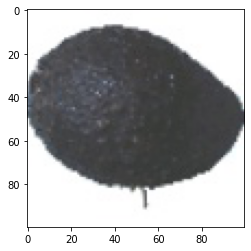

Correct class for image Avocado 
Predicted class for image Carambula 


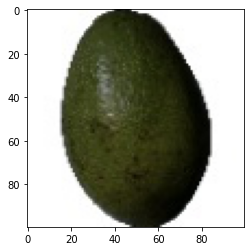

Correct class for image Avocado 
Predicted class for image Carambula 


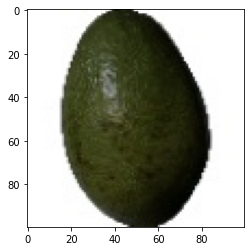

Correct class for image Avocado 
Predicted class for image Apple Golden 1 


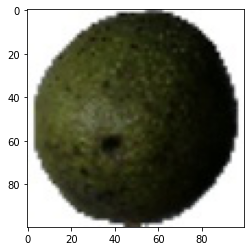

Correct class for image Avocado 
Predicted class for image Carambula 


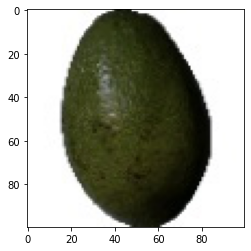

Correct class for image Banana Lady Finger 
Predicted class for image Banana Lady Finger 


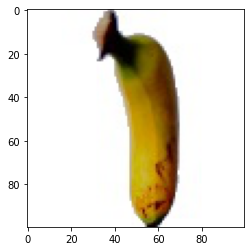

Correct class for image Banana Lady Finger 
Predicted class for image Banana Lady Finger 


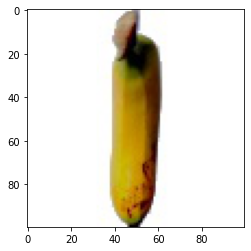

Correct class for image Banana Lady Finger 
Predicted class for image Banana Lady Finger 


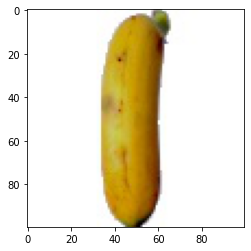

Correct class for image Banana Lady Finger 
Predicted class for image Banana Lady Finger 


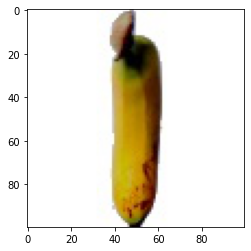

Correct class for image Banana Red 
Predicted class for image Banana Red 


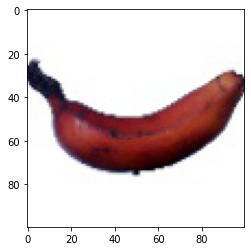

Correct class for image Banana Red 
Predicted class for image Banana Red 


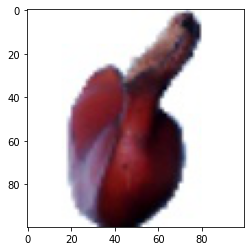

Correct class for image Banana Red 
Predicted class for image Banana Red 


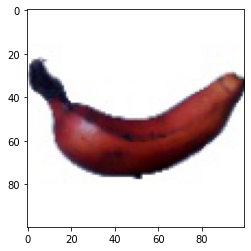

Correct class for image Banana Red 
Predicted class for image Banana Red 


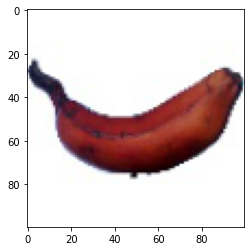

Correct class for image Banana 
Predicted class for image Banana 


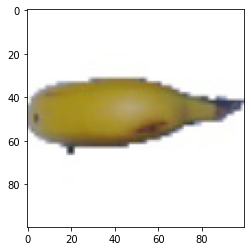

Correct class for image Banana 
Predicted class for image Banana 


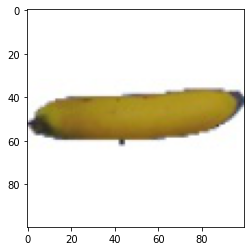

Correct class for image Banana 
Predicted class for image Carambula 


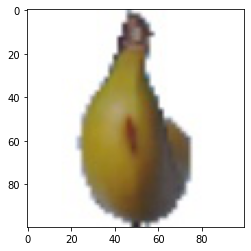

Correct class for image Banana 
Predicted class for image Banana 


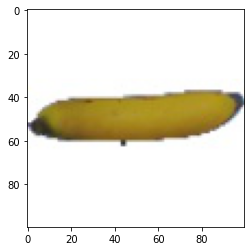

Correct class for image Beetroot 
Predicted class for image Apple Pink Lady 


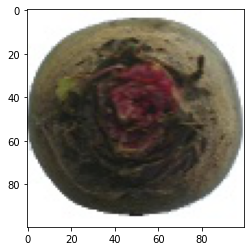

Correct class for image Beetroot 
Predicted class for image Apple Pink Lady 


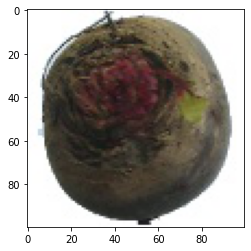

Correct class for image Beetroot 
Predicted class for image Cantaloupe 2 


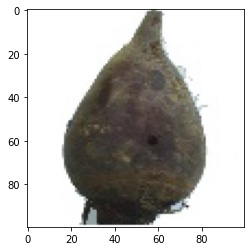

Correct class for image Beetroot 
Predicted class for image Apple Pink Lady 


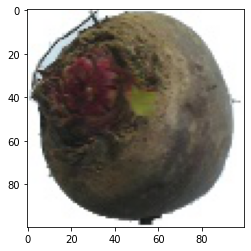

Correct class for image Blueberry 
Predicted class for image Cantaloupe 2 


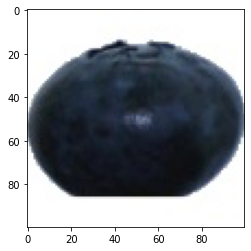

Correct class for image Blueberry 
Predicted class for image Cantaloupe 2 


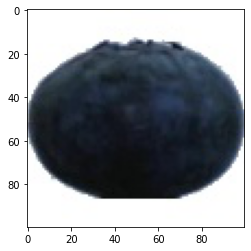

Correct class for image Blueberry 
Predicted class for image Cantaloupe 2 


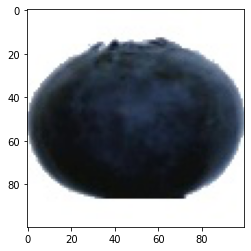

Correct class for image Blueberry 
Predicted class for image Cantaloupe 2 


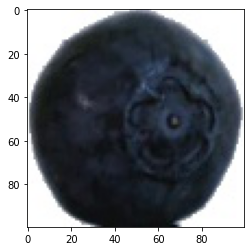

Correct class for image Cactus fruit 
Predicted class for image Carambula 


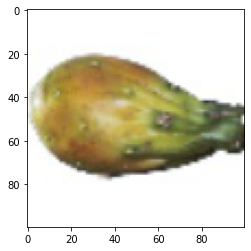

Correct class for image Cactus fruit 
Predicted class for image Carambula 


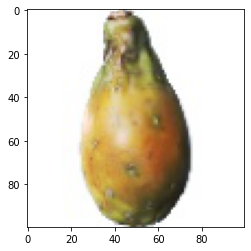

Correct class for image Cactus fruit 
Predicted class for image Carambula 


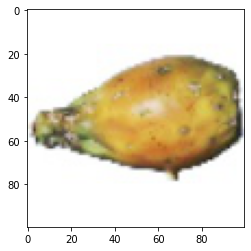

Correct class for image Cactus fruit 
Predicted class for image Carambula 


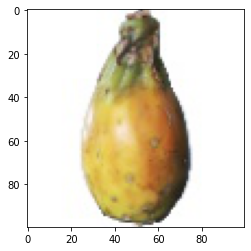

Correct class for image Cantaloupe 1 
Predicted class for image Cantaloupe 1 


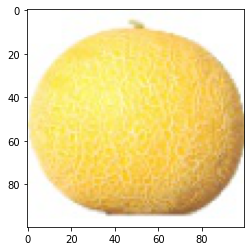

Correct class for image Cantaloupe 1 
Predicted class for image Cantaloupe 1 


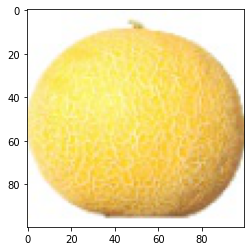

Correct class for image Cantaloupe 1 
Predicted class for image Cantaloupe 1 


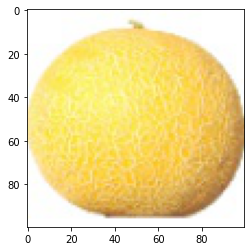

Correct class for image Cantaloupe 1 
Predicted class for image Cantaloupe 1 


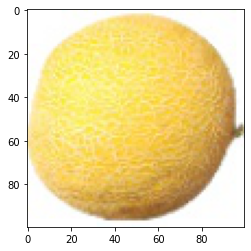

Correct class for image Cantaloupe 2 
Predicted class for image Cantaloupe 2 


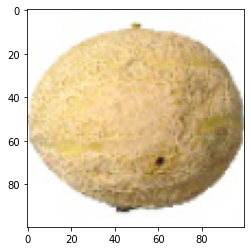

Correct class for image Cantaloupe 2 
Predicted class for image Cantaloupe 2 


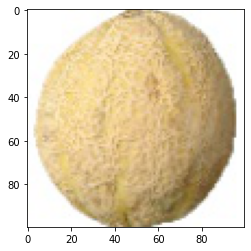

Correct class for image Cantaloupe 2 
Predicted class for image Cantaloupe 2 


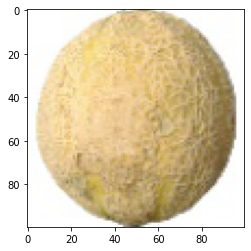

Correct class for image Cantaloupe 2 
Predicted class for image Cantaloupe 2 


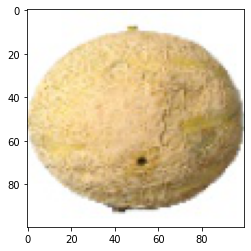

Correct class for image Carambula 
Predicted class for image Carambula 


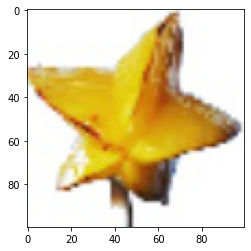

Correct class for image Carambula 
Predicted class for image Carambula 


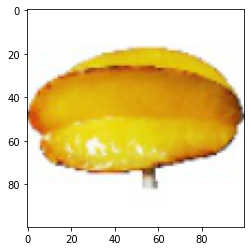

Correct class for image Carambula 
Predicted class for image Carambula 


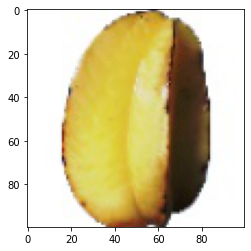

Correct class for image Carambula 
Predicted class for image Carambula 


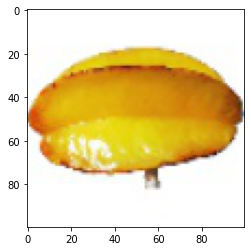

Correct class for image Cauliflower 
Predicted class for image Cauliflower 


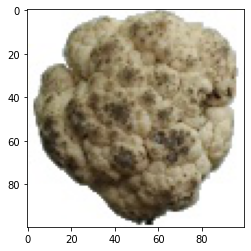

Correct class for image Cauliflower 
Predicted class for image Carambula 


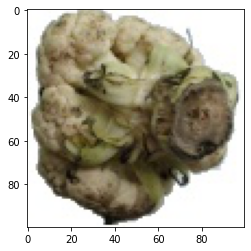

Correct class for image Cauliflower 
Predicted class for image Cauliflower 


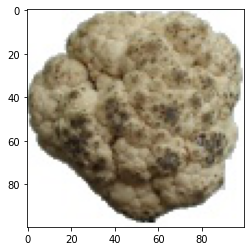

Correct class for image Cauliflower 
Predicted class for image Cauliflower 


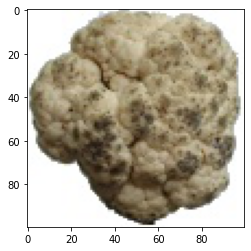

Correct class for image Cherry 1 
Predicted class for image Apple Red 1 


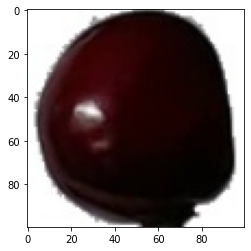

Correct class for image Cherry 1 
Predicted class for image Apricot 


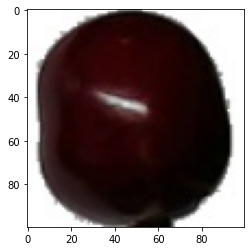

Correct class for image Cherry 1 
Predicted class for image Apple Red 1 


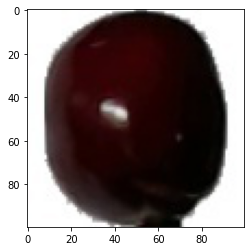

Correct class for image Cherry 1 
Predicted class for image Apple Red 1 


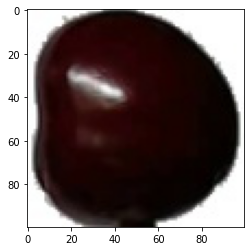

Correct class for image Cherry 2 
Predicted class for image Cherry Rainier 


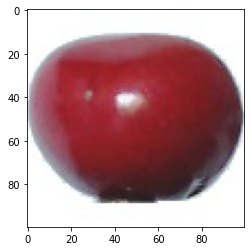

Correct class for image Cherry 2 
Predicted class for image Cherry Rainier 


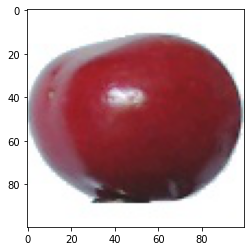

Correct class for image Cherry 2 
Predicted class for image Cherry Rainier 


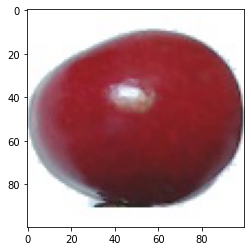

Correct class for image Cherry 2 
Predicted class for image Cherry Rainier 


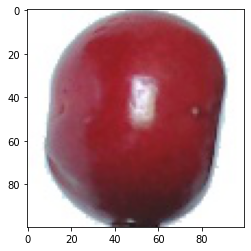

Correct class for image Cherry Rainier 
Predicted class for image Cherry Rainier 


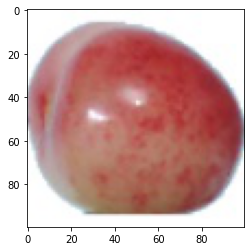

Correct class for image Cherry Rainier 
Predicted class for image Cherry Rainier 


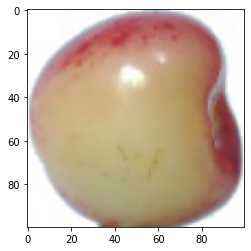

Correct class for image Cherry Rainier 
Predicted class for image Cherry Rainier 


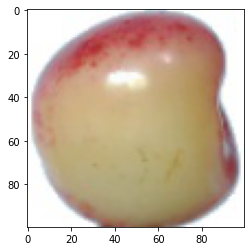

Correct class for image Cherry Rainier 
Predicted class for image Cherry Rainier 


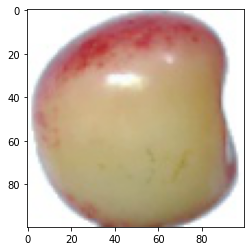

Correct class for image Cherry Wax Black 
Predicted class for image Apple Red Delicious 


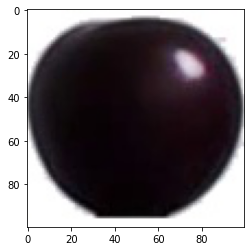

Correct class for image Cherry Wax Black 
Predicted class for image Apple Pink Lady 


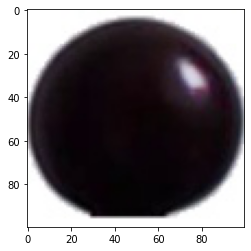

Correct class for image Cherry Wax Black 
Predicted class for image Apple Red Delicious 


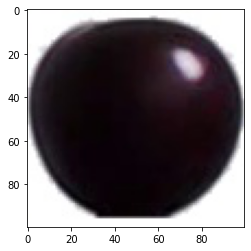

Correct class for image Cherry Wax Black 
Predicted class for image Apple Pink Lady 


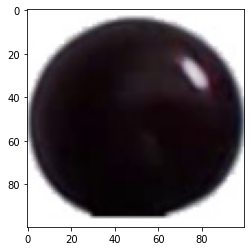

Correct class for image Cherry Wax Red 
Predicted class for image Clementine 


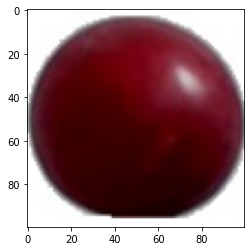

Correct class for image Cherry Wax Red 
Predicted class for image Clementine 


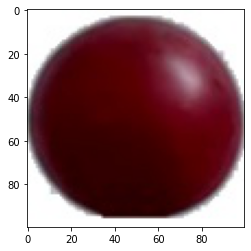

Correct class for image Cherry Wax Red 
Predicted class for image Clementine 


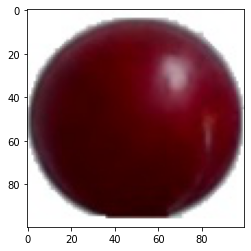

Correct class for image Cherry Wax Red 
Predicted class for image Apple Red Yellow 1 


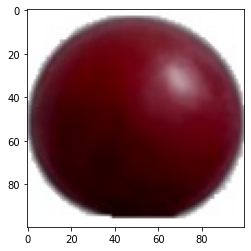

Correct class for image Cherry Wax Yellow 
Predicted class for image Cherry Wax Yellow 


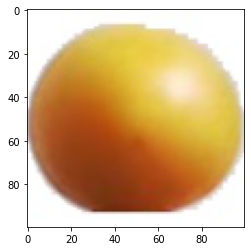

Correct class for image Cherry Wax Yellow 
Predicted class for image Cantaloupe 1 


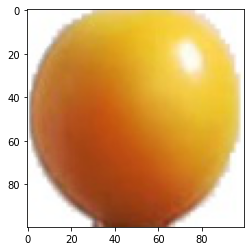

Correct class for image Cherry Wax Yellow 
Predicted class for image Cantaloupe 1 


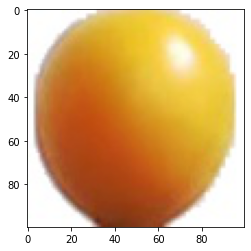

Correct class for image Cherry Wax Yellow 
Predicted class for image Cantaloupe 1 


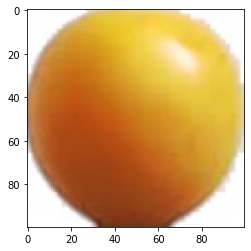

Correct class for image Chestnut 
Predicted class for image Granadilla 


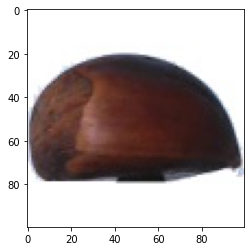

Correct class for image Chestnut 
Predicted class for image Granadilla 


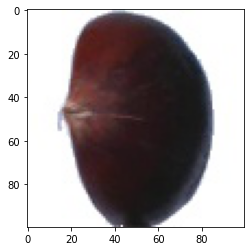

Correct class for image Chestnut 
Predicted class for image Granadilla 


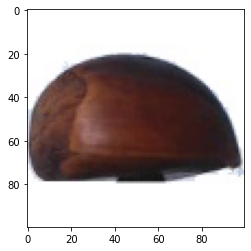

Correct class for image Chestnut 
Predicted class for image Granadilla 


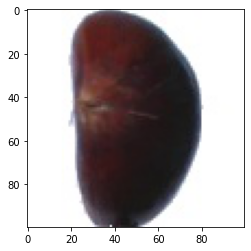

Correct class for image Clementine 
Predicted class for image Clementine 


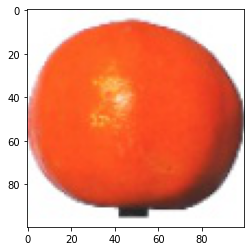

Correct class for image Clementine 
Predicted class for image Clementine 


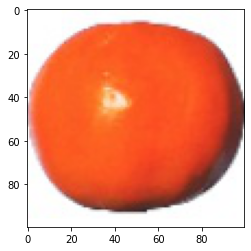

Correct class for image Clementine 
Predicted class for image Clementine 


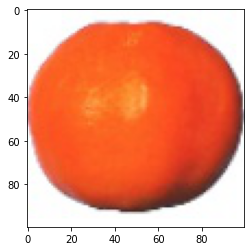

Correct class for image Clementine 
Predicted class for image Clementine 


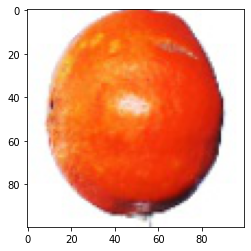

Correct class for image Cocos 
Predicted class for image Cantaloupe 2 


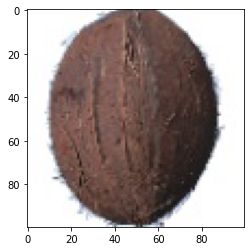

Correct class for image Cocos 
Predicted class for image Cantaloupe 2 


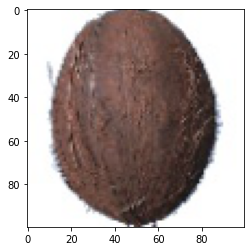

Correct class for image Cocos 
Predicted class for image Cantaloupe 2 


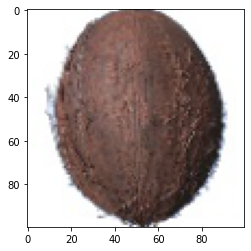

Correct class for image Cocos 
Predicted class for image Cantaloupe 2 


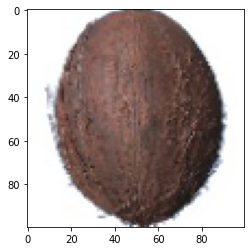

Correct class for image Corn Husk 
Predicted class for image Cantaloupe 2 


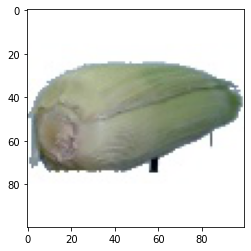

Correct class for image Corn Husk 
Predicted class for image Corn Husk 


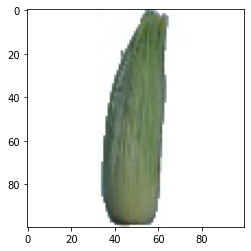

Correct class for image Corn Husk 
Predicted class for image Corn Husk 


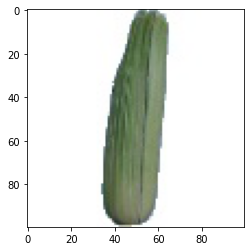

Correct class for image Corn Husk 
Predicted class for image Cauliflower 


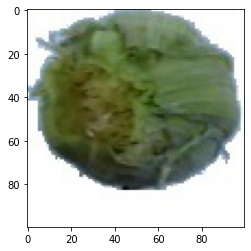

Correct class for image Corn 
Predicted class for image Carambula 


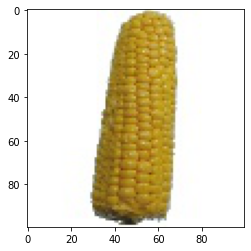

Correct class for image Corn 
Predicted class for image Cantaloupe 1 


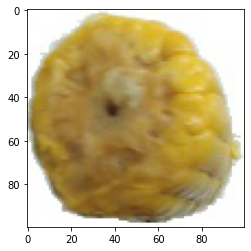

Correct class for image Corn 
Predicted class for image Carambula 


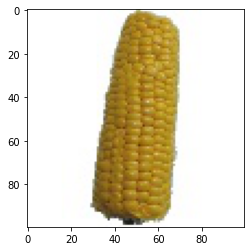

Correct class for image Corn 
Predicted class for image Carambula 


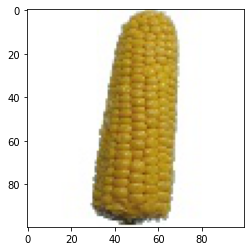

Correct class for image Cucumber Ripe 2 
Predicted class for image Carambula 


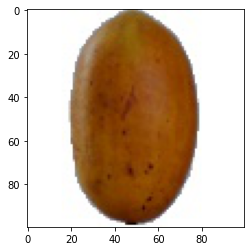

Correct class for image Cucumber Ripe 2 
Predicted class for image Carambula 


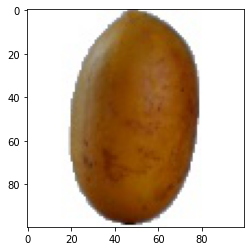

Correct class for image Cucumber Ripe 2 
Predicted class for image Carambula 


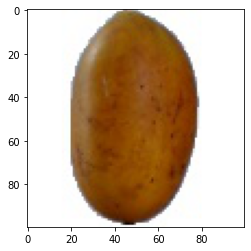

Correct class for image Cucumber Ripe 2 
Predicted class for image Carambula 


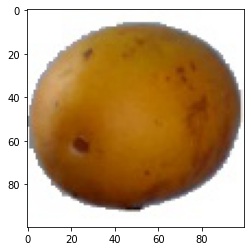

Correct class for image Cucumber Ripe 
Predicted class for image Banana Lady Finger 


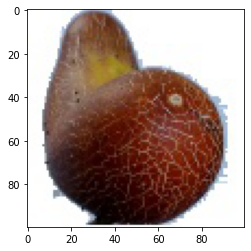

Correct class for image Cucumber Ripe 
Predicted class for image Banana Red 


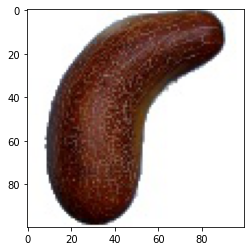

Correct class for image Cucumber Ripe 
Predicted class for image Banana Lady Finger 


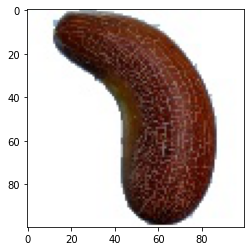

Correct class for image Cucumber Ripe 
Predicted class for image Banana Lady Finger 


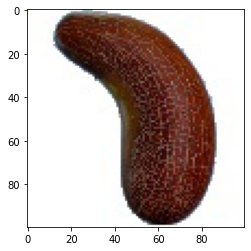

Correct class for image Dates 
Predicted class for image Cantaloupe 2 


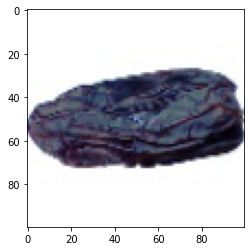

Correct class for image Dates 
Predicted class for image Cantaloupe 2 


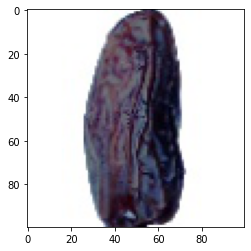

Correct class for image Dates 
Predicted class for image Cantaloupe 2 


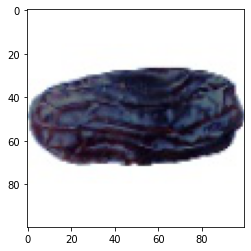

Correct class for image Dates 
Predicted class for image Cauliflower 


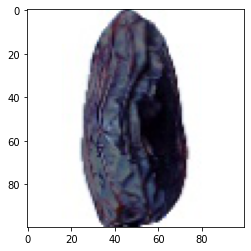

Correct class for image Eggplant 
Predicted class for image Cauliflower 


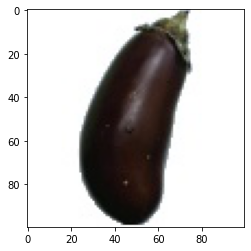

Correct class for image Eggplant 
Predicted class for image Beetroot 


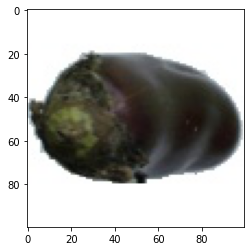

Correct class for image Eggplant 
Predicted class for image Beetroot 


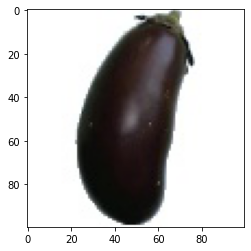

Correct class for image Eggplant 
Predicted class for image Beetroot 


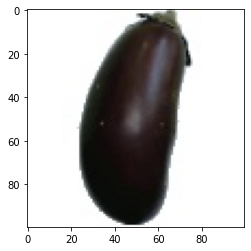

Correct class for image Fig 
Predicted class for image Cherry Rainier 


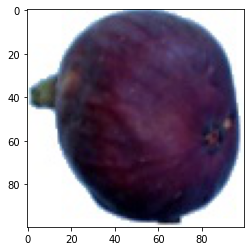

Correct class for image Fig 
Predicted class for image Cantaloupe 2 


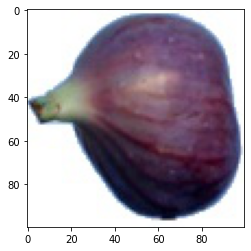

Correct class for image Fig 
Predicted class for image Cherry Rainier 


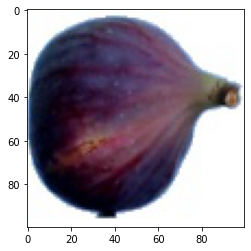

Correct class for image Fig 
Predicted class for image Cantaloupe 2 


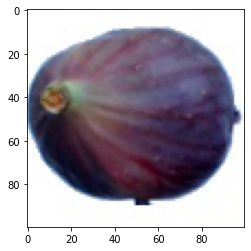

Correct class for image Ginger Root 
Predicted class for image Cantaloupe 2 


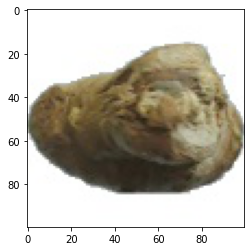

Correct class for image Ginger Root 
Predicted class for image Cantaloupe 2 


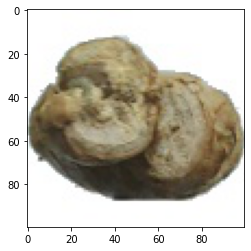

Correct class for image Ginger Root 
Predicted class for image Cantaloupe 2 


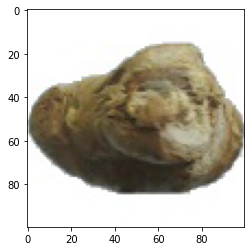

Correct class for image Ginger Root 
Predicted class for image Cantaloupe 2 


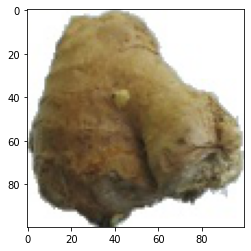

Correct class for image Granadilla 
Predicted class for image Carambula 


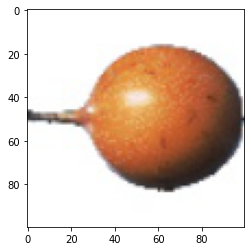

Correct class for image Granadilla 
Predicted class for image Carambula 


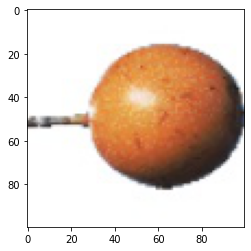

Correct class for image Granadilla 
Predicted class for image Granadilla 


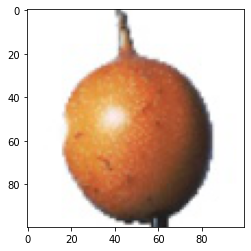

Correct class for image Granadilla 
Predicted class for image Granadilla 


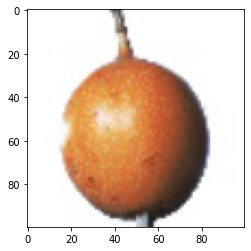

Correct class for image Grape Blue 
Predicted class for image Beetroot 


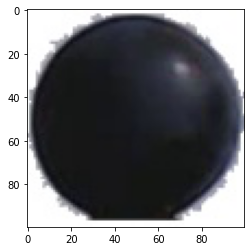

Correct class for image Grape Blue 
Predicted class for image Beetroot 


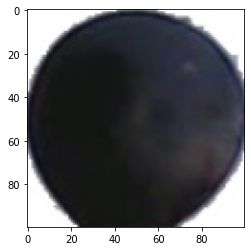

Correct class for image Grape Blue 
Predicted class for image Beetroot 


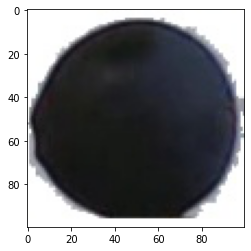

Correct class for image Grape Blue 
Predicted class for image Beetroot 


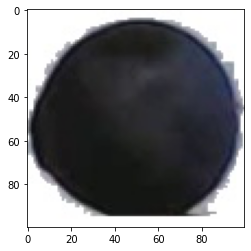

Correct class for image Grape Pink 
Predicted class for image Apple Red Yellow 1 


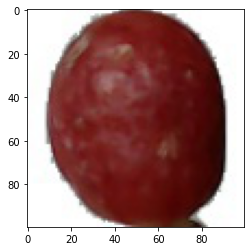

Correct class for image Grape Pink 
Predicted class for image Apple Red Yellow 1 


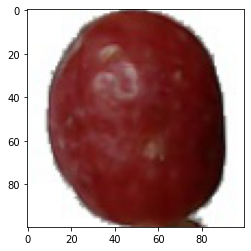

Correct class for image Grape Pink 
Predicted class for image Apple Red Yellow 1 


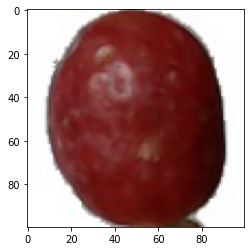

Correct class for image Grape Pink 
Predicted class for image Apple Red Yellow 1 


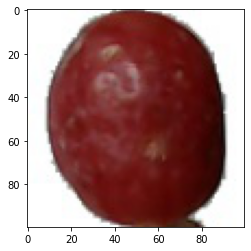

Correct class for image Grape White 2 
Predicted class for image Cantaloupe 1 


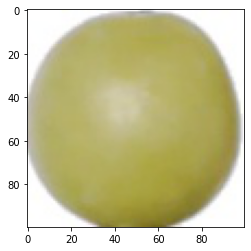

Correct class for image Grape White 2 
Predicted class for image Cantaloupe 1 


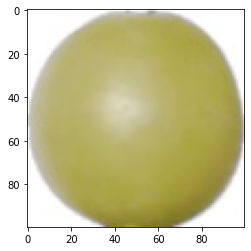

Correct class for image Grape White 2 
Predicted class for image Cantaloupe 1 


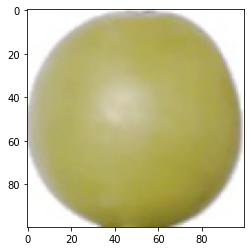

Correct class for image Grape White 2 
Predicted class for image Cantaloupe 1 


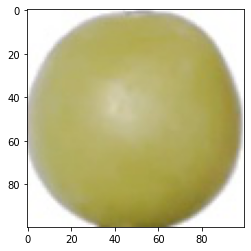

Correct class for image Grape White 3 
Predicted class for image Cantaloupe 1 


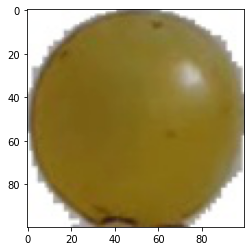

Correct class for image Grape White 3 
Predicted class for image Cantaloupe 1 


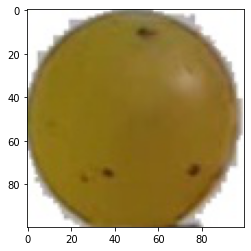

Correct class for image Grape White 3 
Predicted class for image Cantaloupe 1 


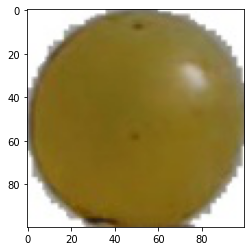

Correct class for image Grape White 3 
Predicted class for image Cantaloupe 1 


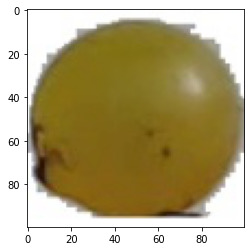

Correct class for image Grape White 4 
Predicted class for image Carambula 


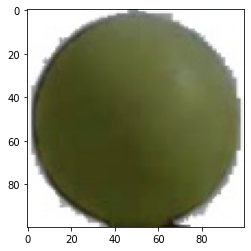

Correct class for image Grape White 4 
Predicted class for image Carambula 


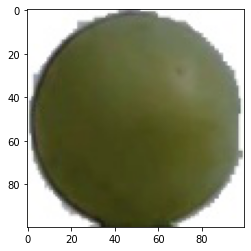

Correct class for image Grape White 4 
Predicted class for image Apple Pink Lady 


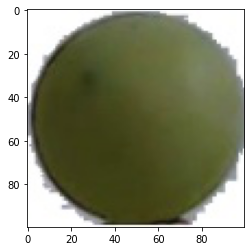

Correct class for image Grape White 4 
Predicted class for image Carambula 


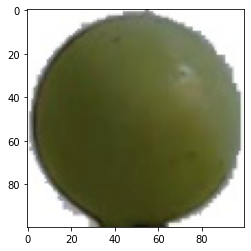

Correct class for image Grape White 
Predicted class for image Cantaloupe 2 


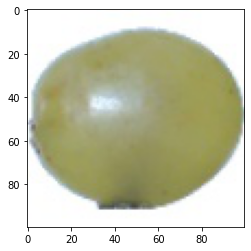

Correct class for image Grape White 
Predicted class for image Cantaloupe 2 


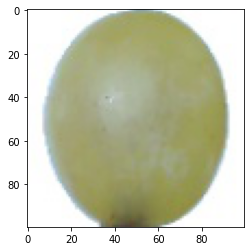

Correct class for image Grape White 
Predicted class for image Cantaloupe 2 


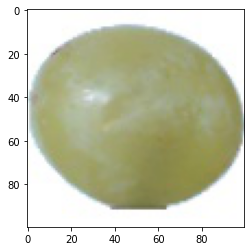

Correct class for image Grape White 
Predicted class for image Cantaloupe 2 


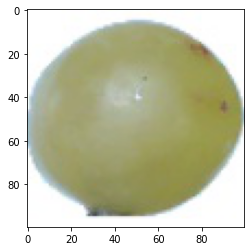

Correct class for image Grapefruit Pink 
Predicted class for image Clementine 


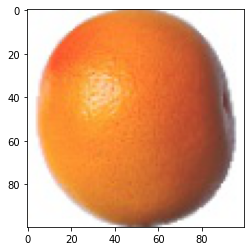

Correct class for image Grapefruit Pink 
Predicted class for image Clementine 


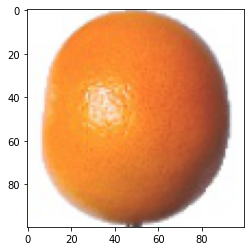

Correct class for image Grapefruit Pink 
Predicted class for image Clementine 


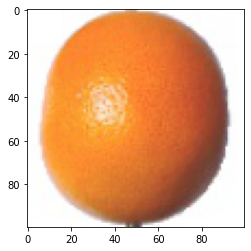

Correct class for image Grapefruit Pink 
Predicted class for image Clementine 


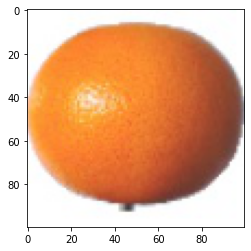

Correct class for image Grapefruit White 
Predicted class for image Apple Red Yellow 1 


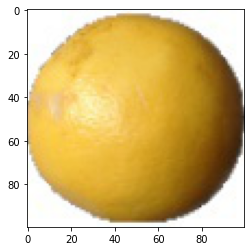

Correct class for image Grapefruit White 
Predicted class for image Cantaloupe 1 


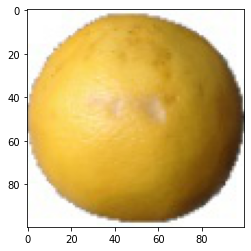

Correct class for image Grapefruit White 
Predicted class for image Cantaloupe 1 


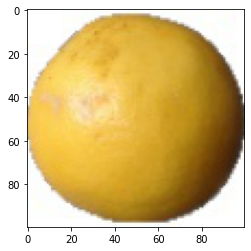

Correct class for image Grapefruit White 
Predicted class for image Apple Red Yellow 1 


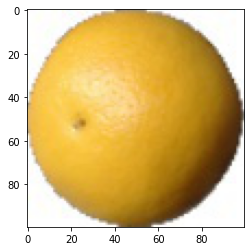

Correct class for image Guava 
Predicted class for image Carambula 


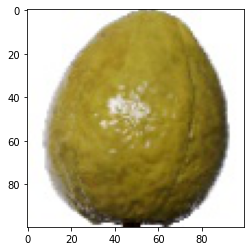

Correct class for image Guava 
Predicted class for image Carambula 


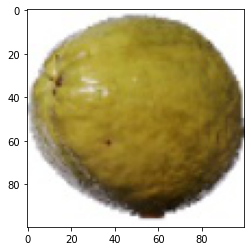

Correct class for image Guava 
Predicted class for image Carambula 


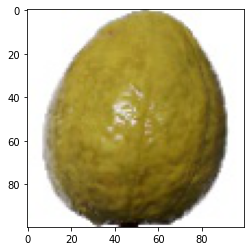

Correct class for image Guava 
Predicted class for image Carambula 


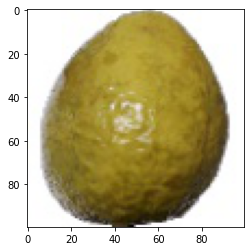

Correct class for image Hazelnut 
Predicted class for image Cantaloupe 2 


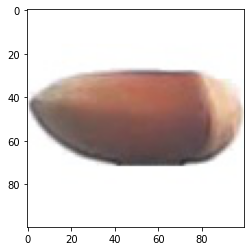

Correct class for image Hazelnut 
Predicted class for image Cantaloupe 2 


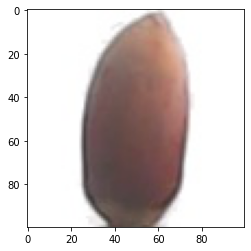

Correct class for image Hazelnut 
Predicted class for image Cantaloupe 2 


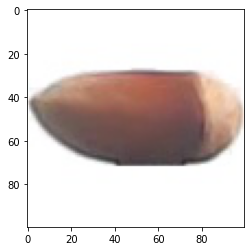

Correct class for image Hazelnut 
Predicted class for image Cantaloupe 2 


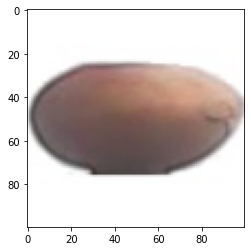

Correct class for image Huckleberry 
Predicted class for image Avocado ripe 


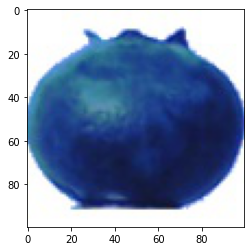

Correct class for image Huckleberry 
Predicted class for image Avocado ripe 


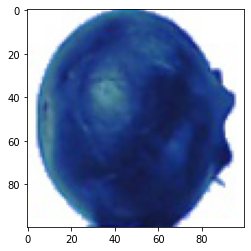

Correct class for image Huckleberry 
Predicted class for image Avocado ripe 


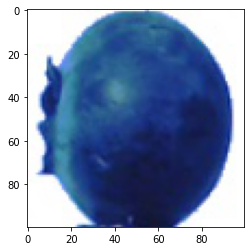

Correct class for image Huckleberry 
Predicted class for image Avocado ripe 


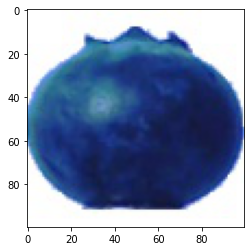

Correct class for image Kaki 
Predicted class for image Apple Red Yellow 1 


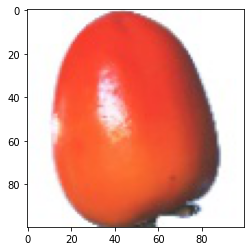

Correct class for image Kaki 
Predicted class for image Cherry Rainier 


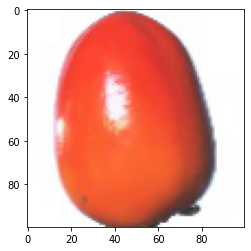

Correct class for image Kaki 
Predicted class for image Clementine 


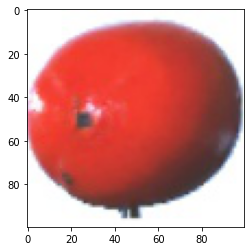

Correct class for image Kaki 
Predicted class for image Clementine 


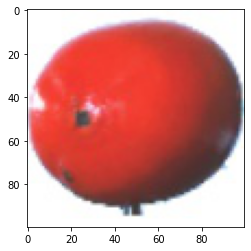

Correct class for image Kiwi 
Predicted class for image Apple Red Yellow 1 


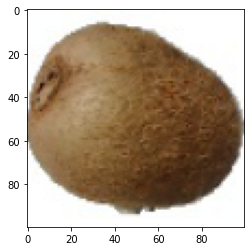

Correct class for image Kiwi 
Predicted class for image Carambula 


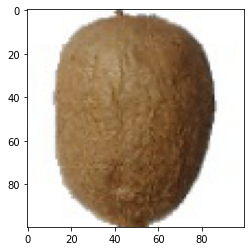

Correct class for image Kiwi 
Predicted class for image Carambula 


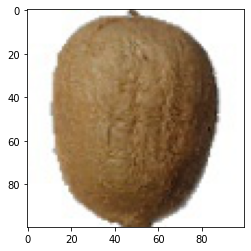

Correct class for image Kiwi 
Predicted class for image Carambula 


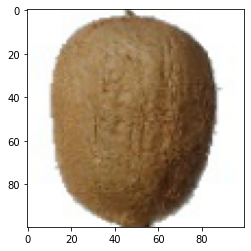

Correct class for image Kohlrabi 
Predicted class for image Cantaloupe 2 


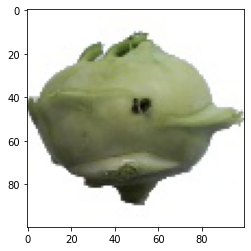

Correct class for image Kohlrabi 
Predicted class for image Cantaloupe 2 


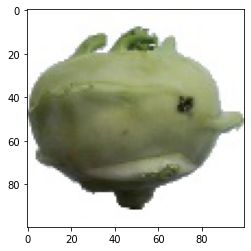

Correct class for image Kohlrabi 
Predicted class for image Cantaloupe 2 


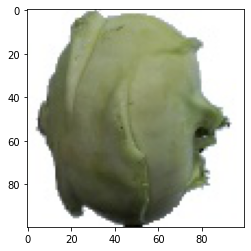

Correct class for image Kohlrabi 
Predicted class for image Cantaloupe 2 


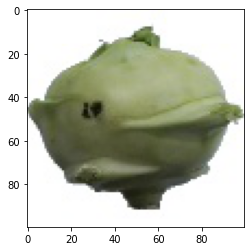

Correct class for image Kumquats 
Predicted class for image Carambula 


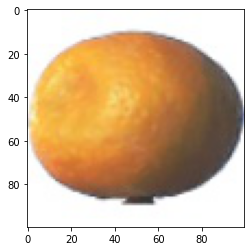

Correct class for image Kumquats 
Predicted class for image Carambula 


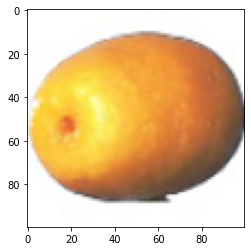

Correct class for image Kumquats 
Predicted class for image Cantaloupe 1 


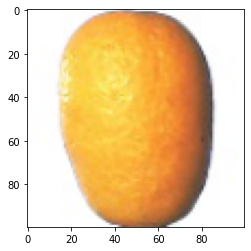

Correct class for image Kumquats 
Predicted class for image Cantaloupe 1 


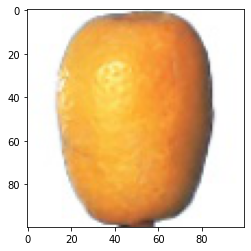

Correct class for image Lemon Meyer 
Predicted class for image Cantaloupe 1 


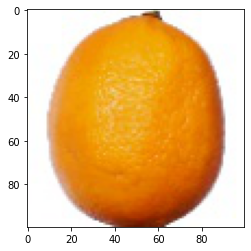

Correct class for image Lemon Meyer 
Predicted class for image Clementine 


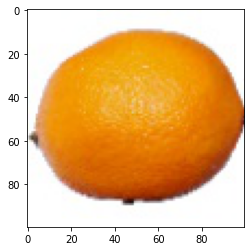

Correct class for image Lemon Meyer 
Predicted class for image Cantaloupe 1 


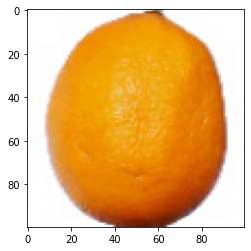

Correct class for image Lemon Meyer 
Predicted class for image Clementine 


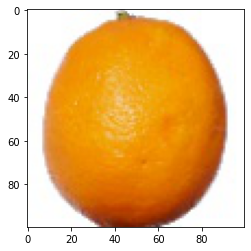

Correct class for image Lemon 
Predicted class for image Carambula 


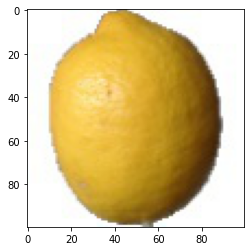

Correct class for image Lemon 
Predicted class for image Carambula 


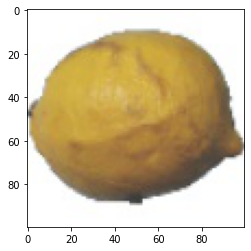

Correct class for image Lemon 
Predicted class for image Carambula 


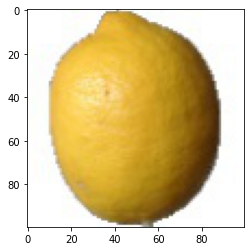

Correct class for image Lemon 
Predicted class for image Carambula 


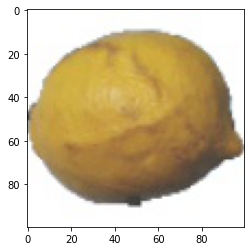

Correct class for image Limes 
Predicted class for image Cantaloupe 1 


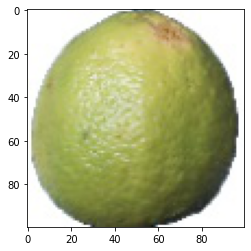

Correct class for image Limes 
Predicted class for image Cantaloupe 1 


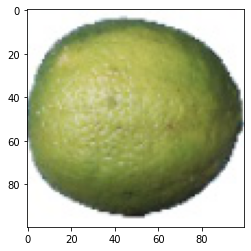

Correct class for image Limes 
Predicted class for image Cantaloupe 1 


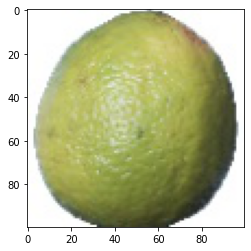

Correct class for image Limes 
Predicted class for image Cantaloupe 1 


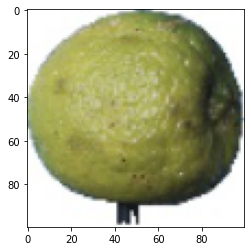

Correct class for image Lychee 
Predicted class for image Cherry Rainier 


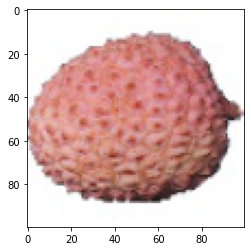

Correct class for image Lychee 
Predicted class for image Cherry Rainier 


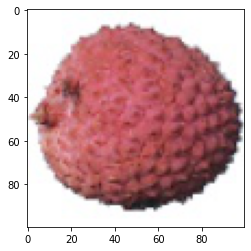

Correct class for image Lychee 
Predicted class for image Cherry Rainier 


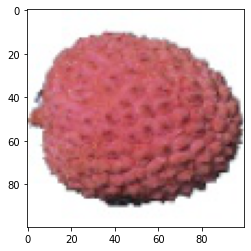

Correct class for image Lychee 
Predicted class for image Cherry Rainier 


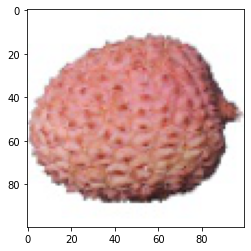

Correct class for image Mandarine 
Predicted class for image Cantaloupe 1 


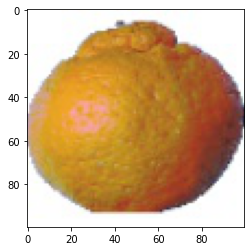

Correct class for image Mandarine 
Predicted class for image Carambula 


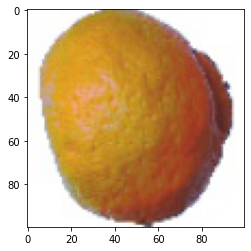

Correct class for image Mandarine 
Predicted class for image Cantaloupe 1 


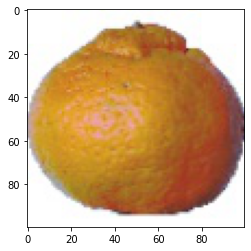

Correct class for image Mandarine 
Predicted class for image Cantaloupe 1 


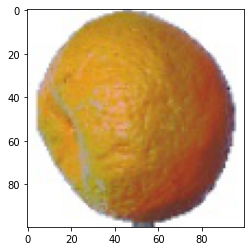

Correct class for image Mango Red 
Predicted class for image Apple Pink Lady 


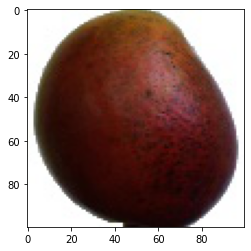

Correct class for image Mango Red 
Predicted class for image Apple Red Yellow 1 


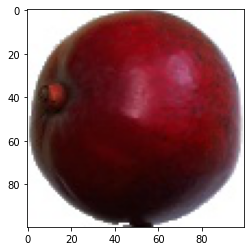

Correct class for image Mango Red 
Predicted class for image Apple Pink Lady 


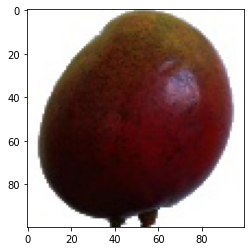

Correct class for image Mango Red 
Predicted class for image Carambula 


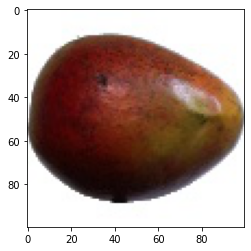

Correct class for image Mango 
Predicted class for image Cantaloupe 2 


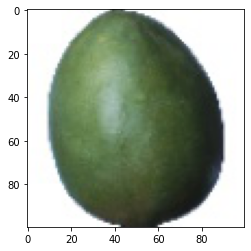

Correct class for image Mango 
Predicted class for image Cantaloupe 2 


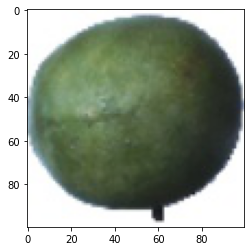

Correct class for image Mango 
Predicted class for image Cantaloupe 2 


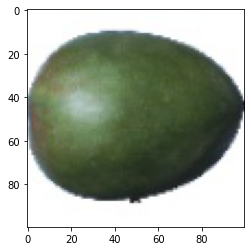

Correct class for image Mango 
Predicted class for image Cantaloupe 2 


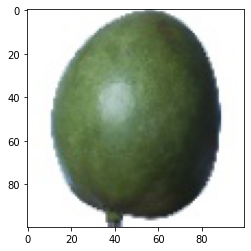

Correct class for image Mangostan 
Predicted class for image Granadilla 


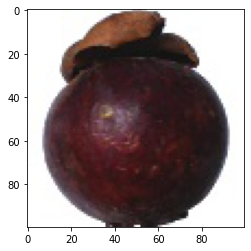

Correct class for image Mangostan 
Predicted class for image Granadilla 


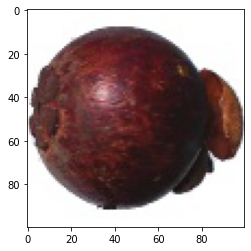

Correct class for image Mangostan 
Predicted class for image Carambula 


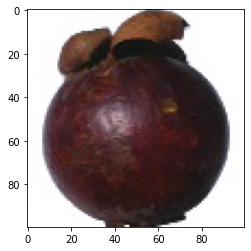

Correct class for image Mangostan 
Predicted class for image Granadilla 


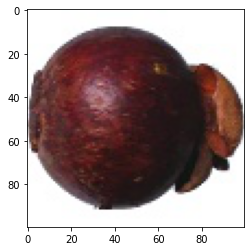

Correct class for image Maracuja 
Predicted class for image Carambula 


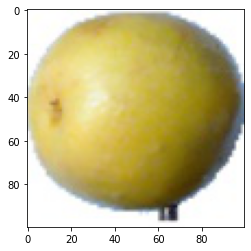

Correct class for image Maracuja 
Predicted class for image Carambula 


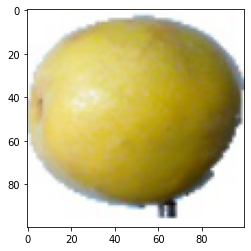

Correct class for image Maracuja 
Predicted class for image Carambula 


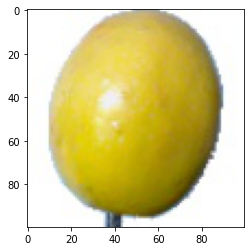

Correct class for image Maracuja 
Predicted class for image Carambula 


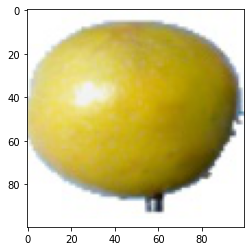

Correct class for image Melon Piel de Sapo 
Predicted class for image Cantaloupe 2 


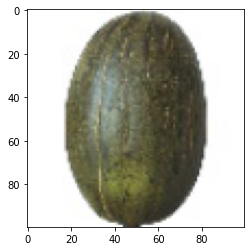

Correct class for image Melon Piel de Sapo 
Predicted class for image Cantaloupe 2 


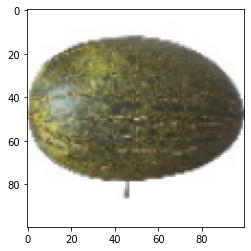

Correct class for image Melon Piel de Sapo 
Predicted class for image Cantaloupe 2 


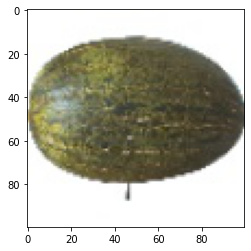

Correct class for image Melon Piel de Sapo 
Predicted class for image Cantaloupe 2 


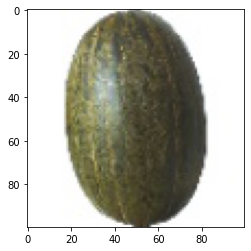

Correct class for image Mulberry 
Predicted class for image Cantaloupe 2 


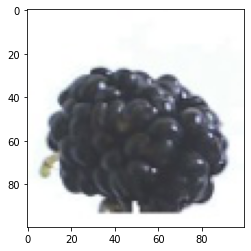

Correct class for image Mulberry 
Predicted class for image Cantaloupe 2 


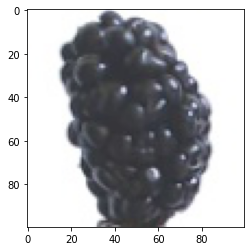

Correct class for image Mulberry 
Predicted class for image Cantaloupe 2 


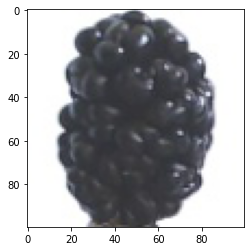

Correct class for image Mulberry 
Predicted class for image Cantaloupe 2 


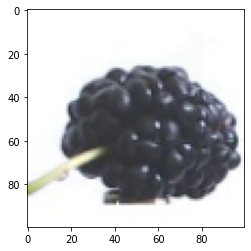

Correct class for image Nectarine Flat 
Predicted class for image Clementine 


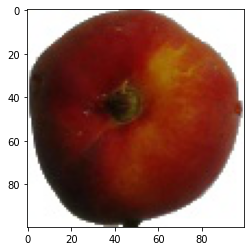

Correct class for image Nectarine Flat 
Predicted class for image Clementine 


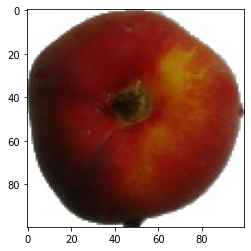

Correct class for image Nectarine Flat 
Predicted class for image Carambula 


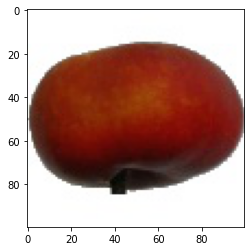

Correct class for image Nectarine Flat 
Predicted class for image Clementine 


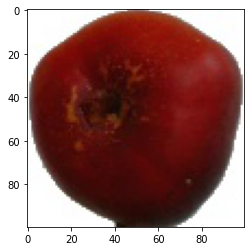

Correct class for image Nectarine 
Predicted class for image Apple Red Yellow 1 


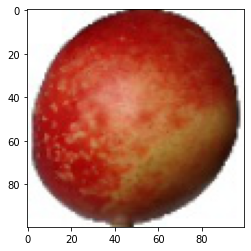

Correct class for image Nectarine 
Predicted class for image Clementine 


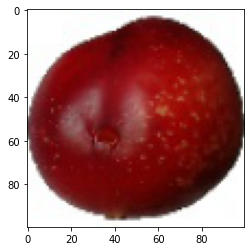

Correct class for image Nectarine 
Predicted class for image Clementine 


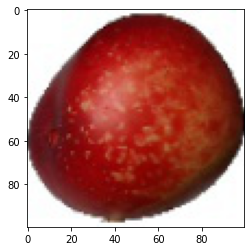

Correct class for image Nectarine 
Predicted class for image Apple Red Yellow 1 


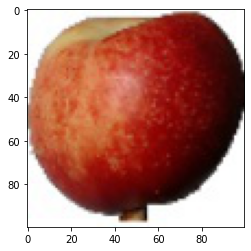

Correct class for image Nut Forest 
Predicted class for image Cherry Wax Yellow 


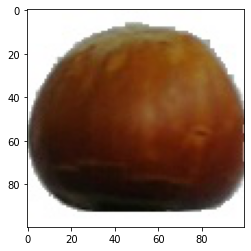

Correct class for image Nut Forest 
Predicted class for image Cherry Wax Yellow 


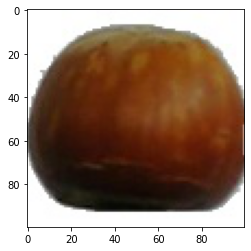

Correct class for image Nut Forest 
Predicted class for image Cherry Wax Yellow 


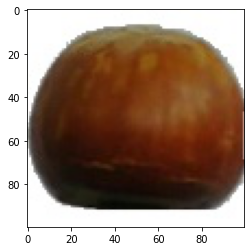

Correct class for image Nut Forest 
Predicted class for image Cherry Wax Yellow 


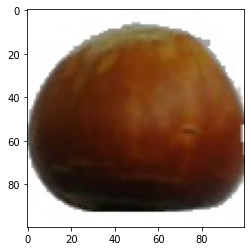

Correct class for image Nut Pecan 
Predicted class for image Carambula 


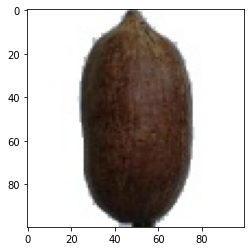

Correct class for image Nut Pecan 
Predicted class for image Apple Pink Lady 


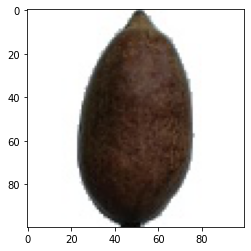

Correct class for image Nut Pecan 
Predicted class for image Cauliflower 


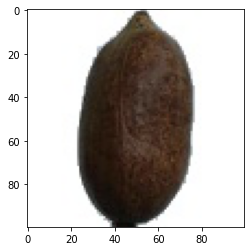

Correct class for image Nut Pecan 
Predicted class for image Cherry Rainier 


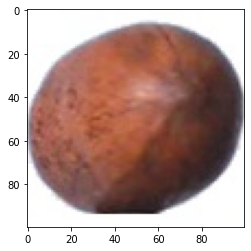

Correct class for image Onion Red Peeled 
Predicted class for image Cherry Rainier 


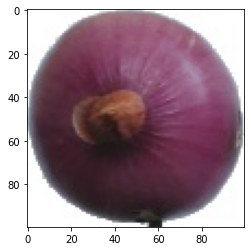

Correct class for image Onion Red Peeled 
Predicted class for image Cherry Rainier 


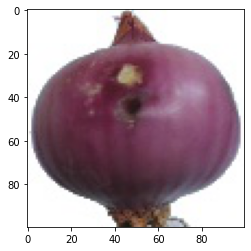

Correct class for image Onion Red Peeled 
Predicted class for image Cherry Rainier 


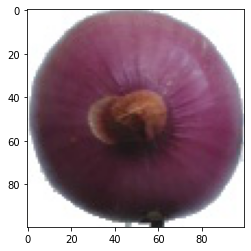

Correct class for image Onion Red Peeled 
Predicted class for image Cantaloupe 2 


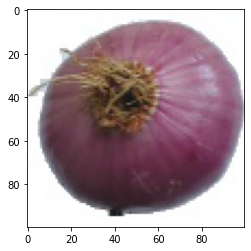

Correct class for image Onion Red 
Predicted class for image Cherry Rainier 


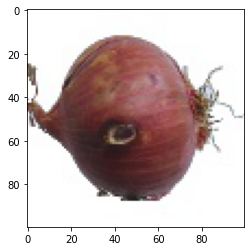

Correct class for image Onion Red 
Predicted class for image Cherry Rainier 


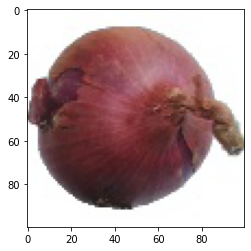

Correct class for image Onion Red 
Predicted class for image Cherry Rainier 


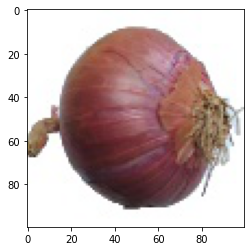

Correct class for image Onion Red 
Predicted class for image Cherry Rainier 


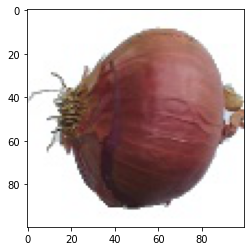

Correct class for image Onion White 
Predicted class for image Cherry Wax Yellow 


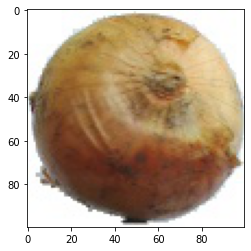

Correct class for image Onion White 
Predicted class for image Cherry Wax Yellow 


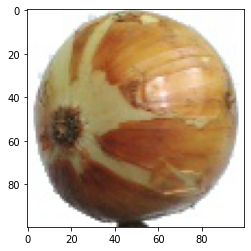

Correct class for image Onion White 
Predicted class for image Cantaloupe 1 


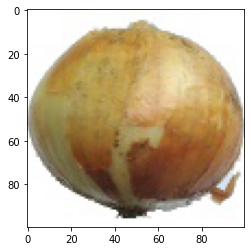

Correct class for image Onion White 
Predicted class for image Cherry Wax Yellow 


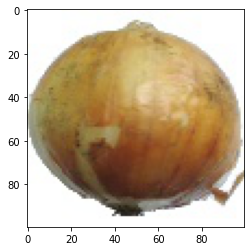

Correct class for image Orange 
Predicted class for image Clementine 


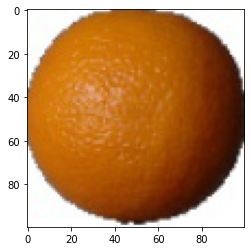

Correct class for image Orange 
Predicted class for image Apple Red Yellow 1 


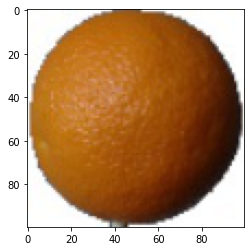

Correct class for image Orange 
Predicted class for image Clementine 


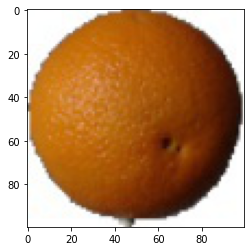

Correct class for image Orange 
Predicted class for image Clementine 


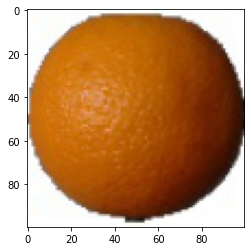

Correct class for image Papaya 
Predicted class for image Carambula 


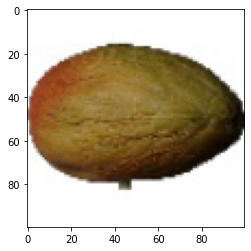

Correct class for image Papaya 
Predicted class for image Carambula 


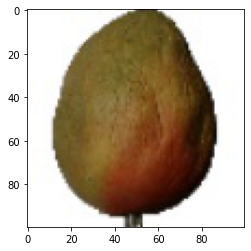

Correct class for image Papaya 
Predicted class for image Carambula 


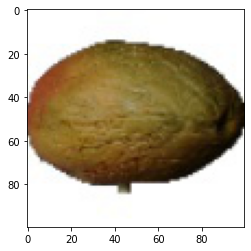

Correct class for image Papaya 
Predicted class for image Carambula 


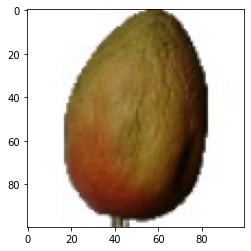

Correct class for image Passion Fruit 
Predicted class for image Cantaloupe 2 


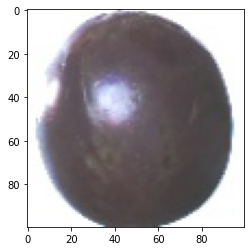

Correct class for image Passion Fruit 
Predicted class for image Cantaloupe 2 


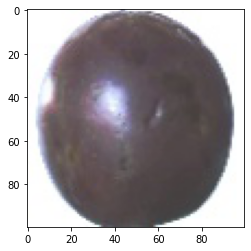

Correct class for image Passion Fruit 
Predicted class for image Cantaloupe 2 


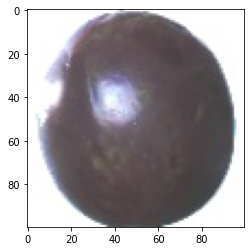

Correct class for image Passion Fruit 
Predicted class for image Cantaloupe 2 


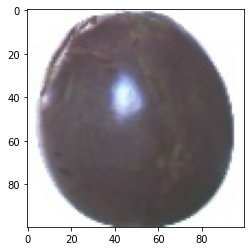

Correct class for image Peach 2 
Predicted class for image Cantaloupe 1 


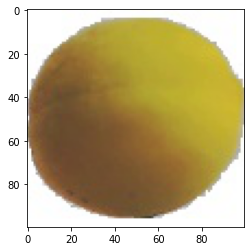

Correct class for image Peach 2 
Predicted class for image Cantaloupe 1 


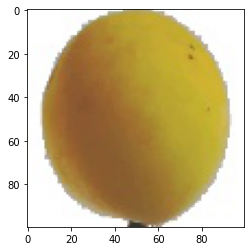

Correct class for image Peach 2 
Predicted class for image Cantaloupe 1 


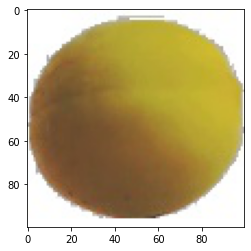

Correct class for image Peach 2 
Predicted class for image Cantaloupe 1 


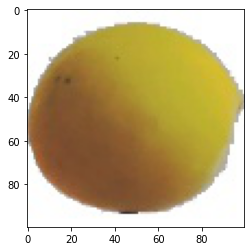

Correct class for image Peach Flat 
Predicted class for image Cantaloupe 2 


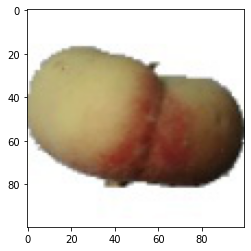

Correct class for image Peach Flat 
Predicted class for image Cantaloupe 2 


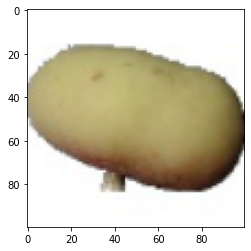

Correct class for image Peach Flat 
Predicted class for image Carambula 


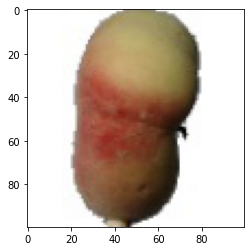

Correct class for image Peach Flat 
Predicted class for image Carambula 


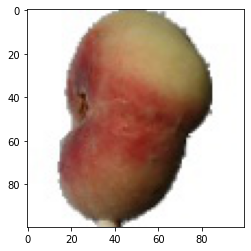

Correct class for image Peach 
Predicted class for image Apple Red Yellow 1 


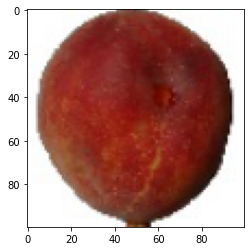

Correct class for image Peach 
Predicted class for image Apple Red Yellow 1 


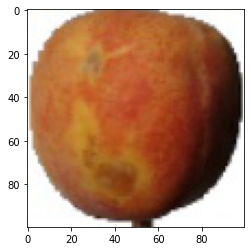

Correct class for image Peach 
Predicted class for image Apple Red Yellow 1 


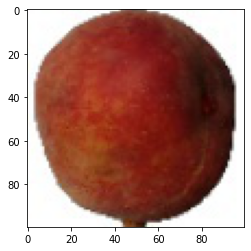

Correct class for image Peach 
Predicted class for image Apple Red Yellow 1 


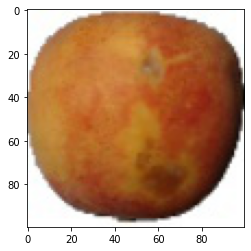

Correct class for image Pear 2 
Predicted class for image Cherry Rainier 


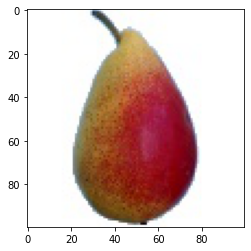

Correct class for image Pear 2 
Predicted class for image Cantaloupe 2 


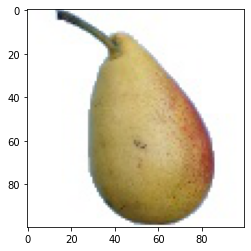

Correct class for image Pear 2 
Predicted class for image Cherry Wax Yellow 


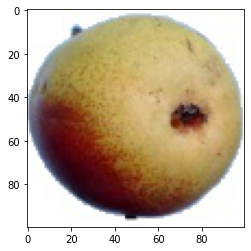

Correct class for image Pear 2 
Predicted class for image Cantaloupe 1 


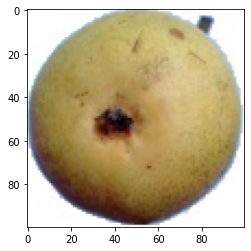

Correct class for image Pear Abate 
Predicted class for image Cantaloupe 2 


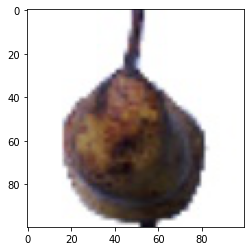

Correct class for image Pear Abate 
Predicted class for image Cantaloupe 2 


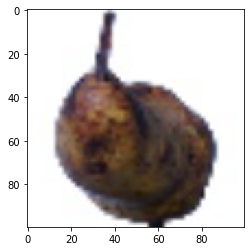

Correct class for image Pear Abate 
Predicted class for image Banana Lady Finger 


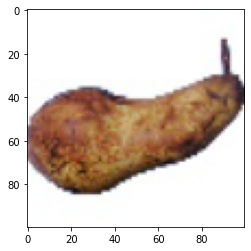

Correct class for image Pear Abate 
Predicted class for image Carambula 


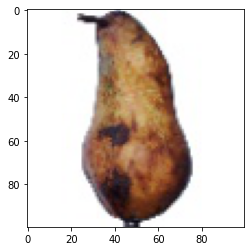

Correct class for image Pear Forelle 
Predicted class for image Carambula 


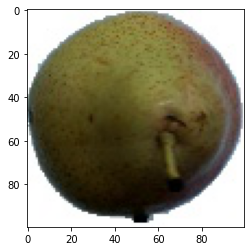

Correct class for image Pear Forelle 
Predicted class for image Apple Pink Lady 


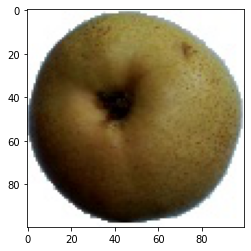

Correct class for image Pear Forelle 
Predicted class for image Carambula 


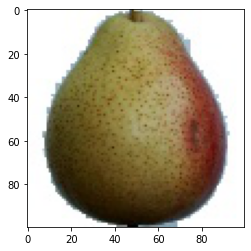

Correct class for image Pear Forelle 
Predicted class for image Apple Pink Lady 


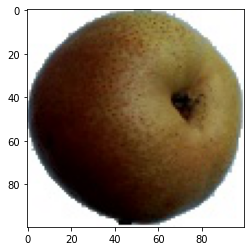

Correct class for image Pear Kaiser 
Predicted class for image Banana Red 


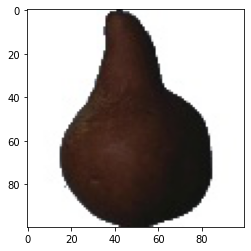

Correct class for image Pear Kaiser 
Predicted class for image Banana Red 


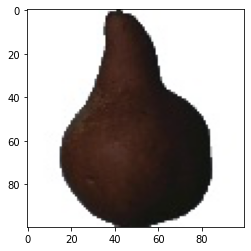

Correct class for image Pear Kaiser 
Predicted class for image Banana Red 


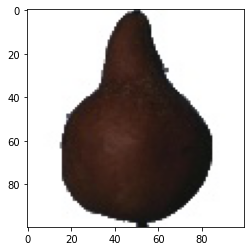

Correct class for image Pear Kaiser 
Predicted class for image Banana Red 


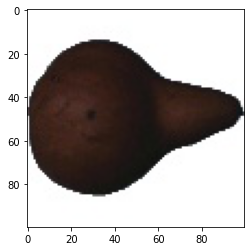

Correct class for image Pear Monster 
Predicted class for image Carambula 


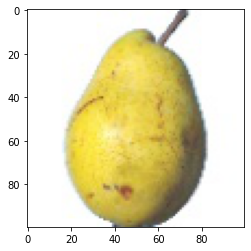

Correct class for image Pear Monster 
Predicted class for image Carambula 


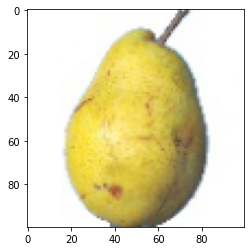

Correct class for image Pear Monster 
Predicted class for image Carambula 


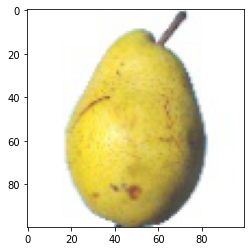

Correct class for image Pear Monster 
Predicted class for image Carambula 


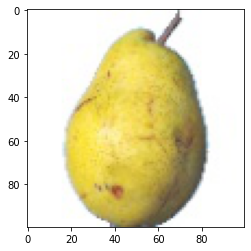

Correct class for image Pear Red 
Predicted class for image Clementine 


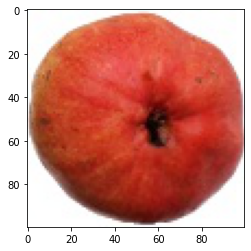

Correct class for image Pear Red 
Predicted class for image Clementine 


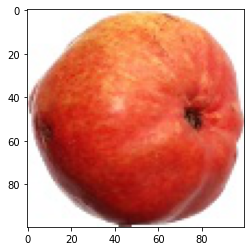

Correct class for image Pear Red 
Predicted class for image Apple Red Yellow 1 


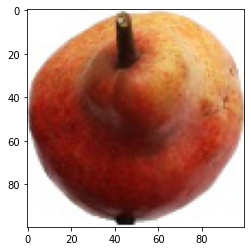

Correct class for image Pear Red 
Predicted class for image Cherry Rainier 


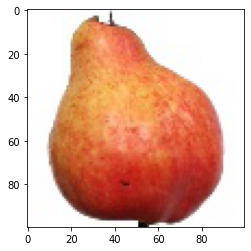

Correct class for image Pear Stone 
Predicted class for image Cauliflower 


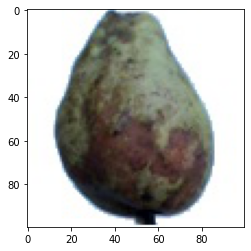

Correct class for image Pear Stone 
Predicted class for image Cantaloupe 2 


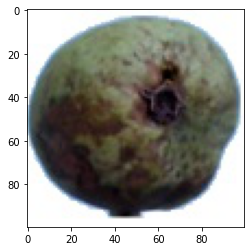

Correct class for image Pear Stone 
Predicted class for image Cauliflower 


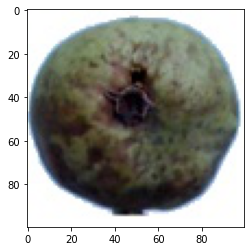

Correct class for image Pear Stone 
Predicted class for image Cantaloupe 2 


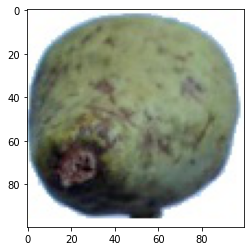

Correct class for image Pear Williams 
Predicted class for image Cantaloupe 2 


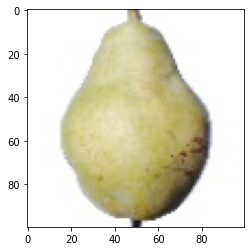

Correct class for image Pear Williams 
Predicted class for image Cantaloupe 2 


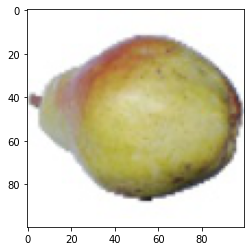

Correct class for image Pear Williams 
Predicted class for image Carambula 


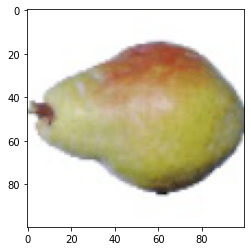

Correct class for image Pear Williams 
Predicted class for image Carambula 


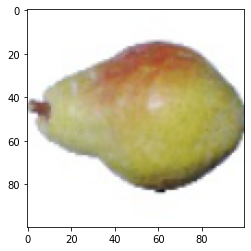

Correct class for image Pear 
Predicted class for image Carambula 


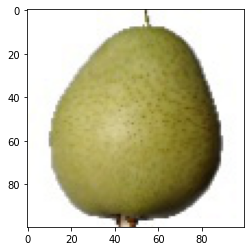

Correct class for image Pear 
Predicted class for image Carambula 


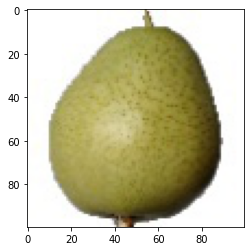

Correct class for image Pear 
Predicted class for image Carambula 


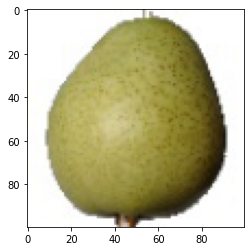

Correct class for image Pear 
Predicted class for image Carambula 


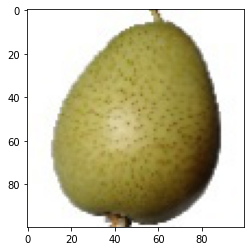

Correct class for image Pepino 
Predicted class for image Cantaloupe 2 


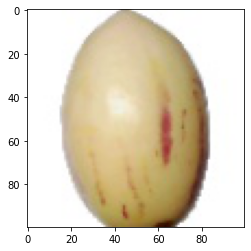

Correct class for image Pepino 
Predicted class for image Cantaloupe 2 


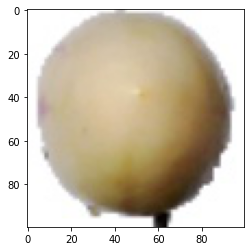

Correct class for image Pepino 
Predicted class for image Cantaloupe 2 


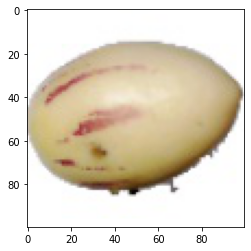

Correct class for image Pepino 
Predicted class for image Cantaloupe 2 


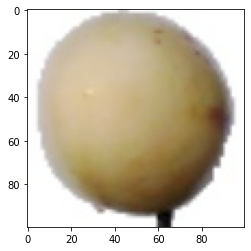

Correct class for image Pepper Green 
Predicted class for image Apple Pink Lady 


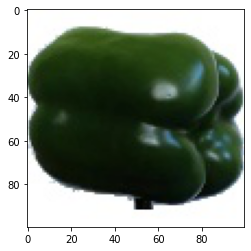

Correct class for image Pepper Green 
Predicted class for image Apple Pink Lady 


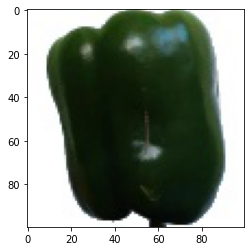

Correct class for image Pepper Green 
Predicted class for image Cauliflower 


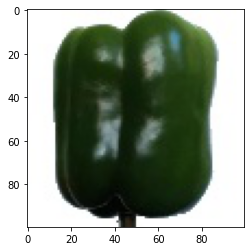

Correct class for image Pepper Green 
Predicted class for image Cauliflower 


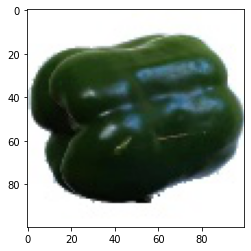

Correct class for image Pepper Orange 
Predicted class for image Clementine 


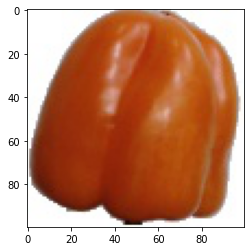

Correct class for image Pepper Orange 
Predicted class for image Clementine 


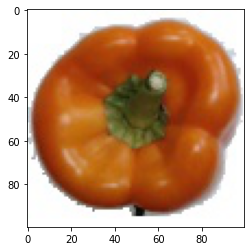

Correct class for image Pepper Orange 
Predicted class for image Clementine 


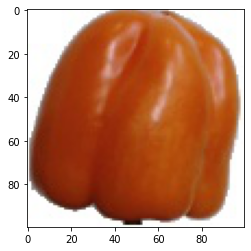

Correct class for image Pepper Orange 
Predicted class for image Clementine 


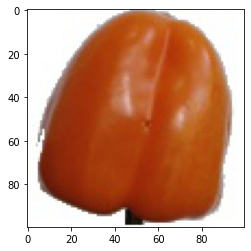

Correct class for image Pepper Red 
Predicted class for image Clementine 


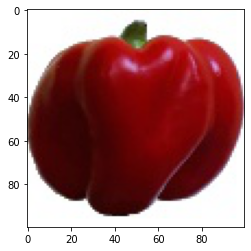

Correct class for image Pepper Red 
Predicted class for image Clementine 


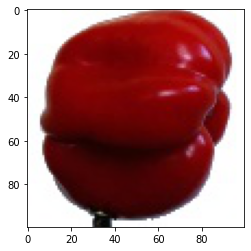

Correct class for image Pepper Red 
Predicted class for image Clementine 


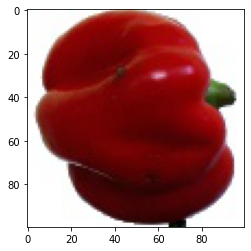

Correct class for image Pepper Red 
Predicted class for image Clementine 


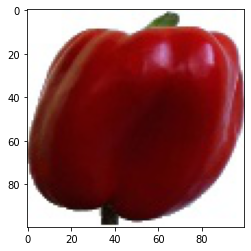

Correct class for image Pepper Yellow 
Predicted class for image Carambula 


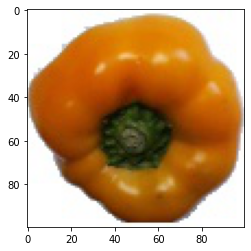

Correct class for image Pepper Yellow 
Predicted class for image Clementine 


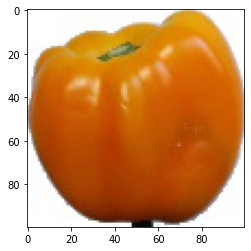

Correct class for image Pepper Yellow 
Predicted class for image Clementine 


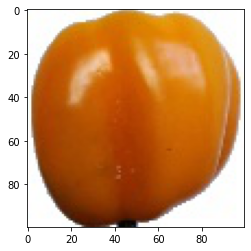

Correct class for image Pepper Yellow 
Predicted class for image Carambula 


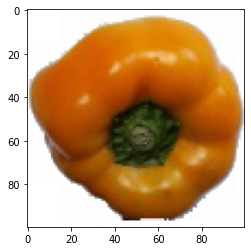

Correct class for image Physalis with Husk 
Predicted class for image Carambula 


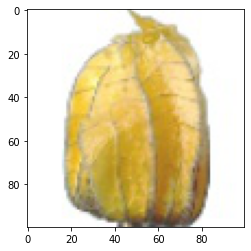

Correct class for image Physalis with Husk 
Predicted class for image Carambula 


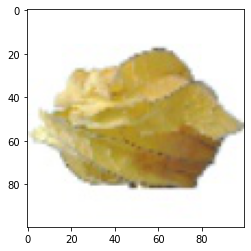

Correct class for image Physalis with Husk 
Predicted class for image Carambula 


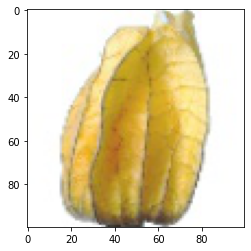

Correct class for image Physalis with Husk 
Predicted class for image Carambula 


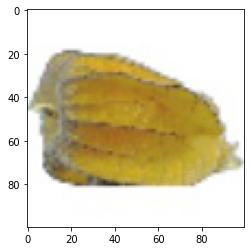

Correct class for image Physalis 
Predicted class for image Cantaloupe 1 


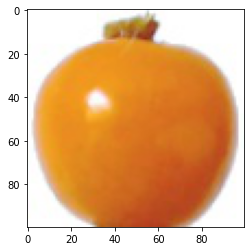

Correct class for image Physalis 
Predicted class for image Clementine 


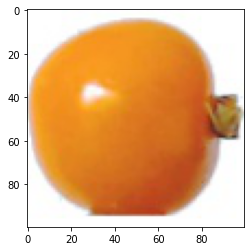

Correct class for image Physalis 
Predicted class for image Cantaloupe 1 


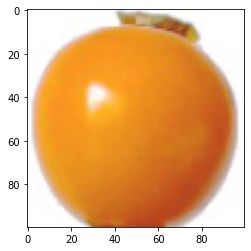

Correct class for image Physalis 
Predicted class for image Clementine 


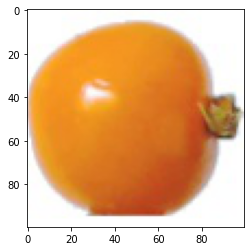

Correct class for image Pineapple Mini 
Predicted class for image Carambula 


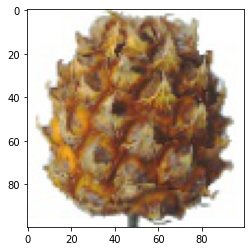

Correct class for image Pineapple Mini 
Predicted class for image Carambula 


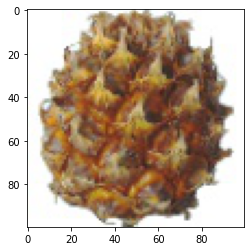

Correct class for image Pineapple Mini 
Predicted class for image Carambula 


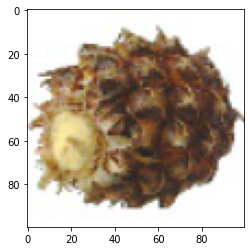

Correct class for image Pineapple Mini 
Predicted class for image Cantaloupe 1 


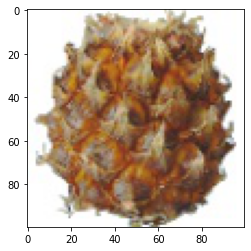

Correct class for image Pineapple 
Predicted class for image Cantaloupe 2 


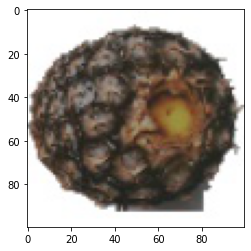

Correct class for image Pineapple 
Predicted class for image Carambula 


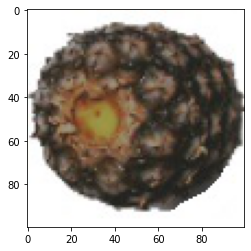

Correct class for image Pineapple 
Predicted class for image Carambula 


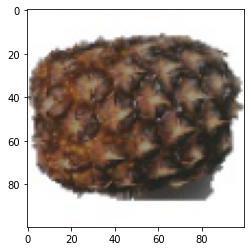

Correct class for image Pineapple 
Predicted class for image Carambula 


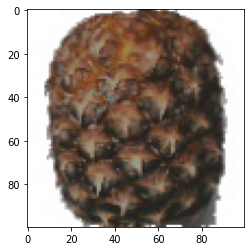

Correct class for image Pitahaya Red 
Predicted class for image Cherry Rainier 


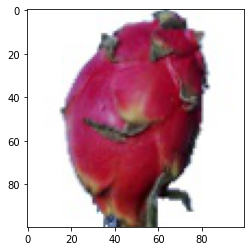

Correct class for image Pitahaya Red 
Predicted class for image Cherry Rainier 


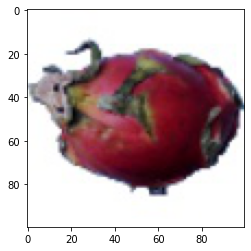

Correct class for image Pitahaya Red 
Predicted class for image Cherry Rainier 


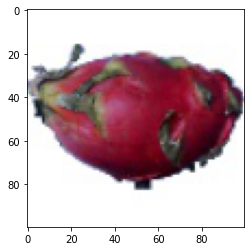

Correct class for image Pitahaya Red 
Predicted class for image Cherry Rainier 


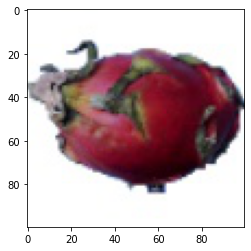

Correct class for image Plum 2 
Predicted class for image Apple Red 1 


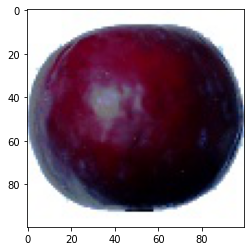

Correct class for image Plum 2 
Predicted class for image Cherry 2 


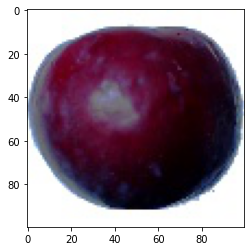

Correct class for image Plum 2 
Predicted class for image Apple Red 1 


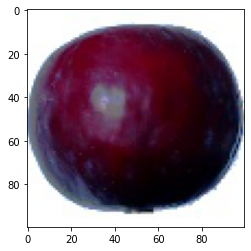

Correct class for image Plum 2 
Predicted class for image Cherry 2 


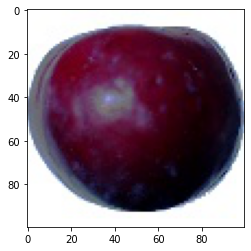

Correct class for image Plum 3 
Predicted class for image Beetroot 


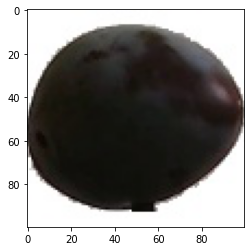

Correct class for image Plum 3 
Predicted class for image Cantaloupe 2 


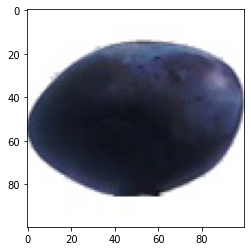

Correct class for image Plum 3 
Predicted class for image Beetroot 


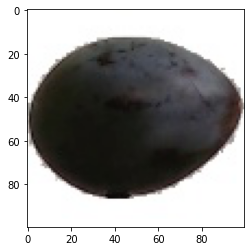

Correct class for image Plum 3 
Predicted class for image Beetroot 


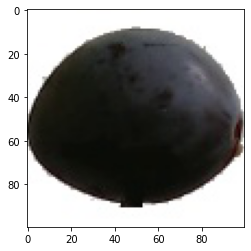

Correct class for image Plum 
Predicted class for image Apple Red 1 


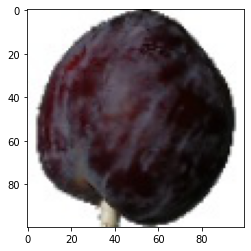

Correct class for image Plum 
Predicted class for image Apple Red 1 


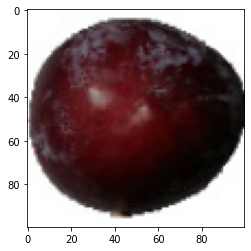

Correct class for image Plum 
Predicted class for image Apple Red 1 


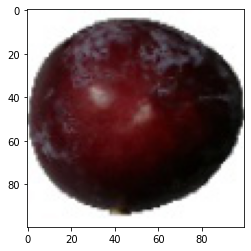

Correct class for image Plum 
Predicted class for image Apple Red 1 


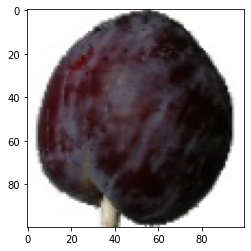

Correct class for image Pomegranate 
Predicted class for image Cherry Rainier 


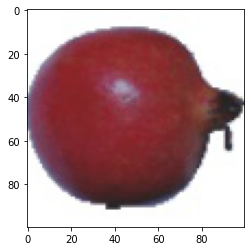

Correct class for image Pomegranate 
Predicted class for image Cherry Rainier 


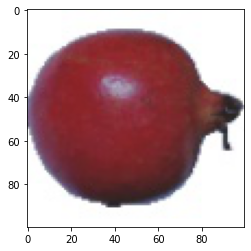

Correct class for image Pomegranate 
Predicted class for image Cherry Rainier 


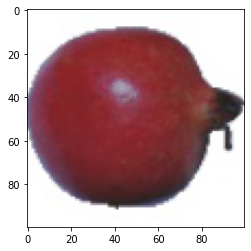

Correct class for image Pomegranate 
Predicted class for image Cherry Rainier 


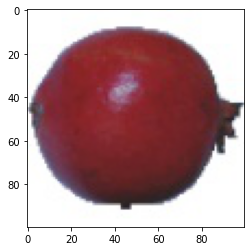

Correct class for image Pomelo Sweetie 
Predicted class for image Carambula 


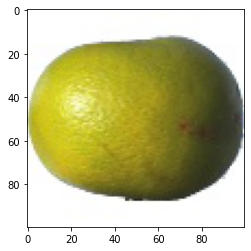

Correct class for image Pomelo Sweetie 
Predicted class for image Carambula 


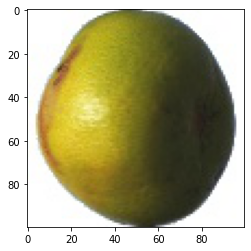

Correct class for image Pomelo Sweetie 
Predicted class for image Carambula 


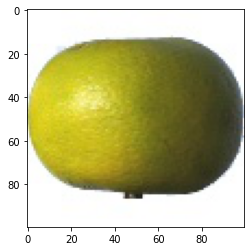

Correct class for image Pomelo Sweetie 
Predicted class for image Carambula 


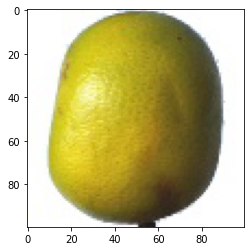

Correct class for image Potato Red Washed 
Predicted class for image Cherry 2 


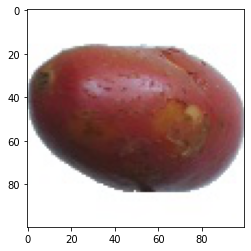

Correct class for image Potato Red Washed 
Predicted class for image Cherry 2 


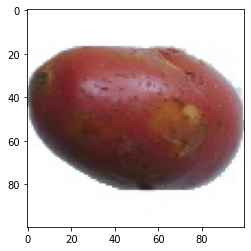

Correct class for image Potato Red Washed 
Predicted class for image Cherry Rainier 


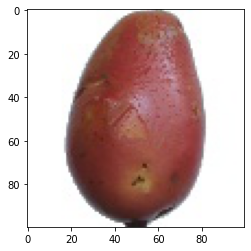

Correct class for image Potato Red Washed 
Predicted class for image Cherry Rainier 


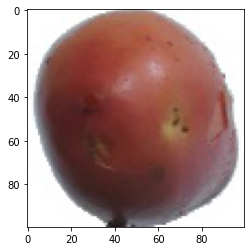

Correct class for image Potato Red 
Predicted class for image Cherry Rainier 


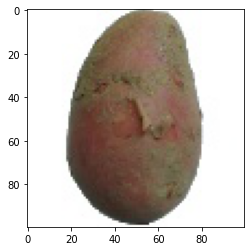

Correct class for image Potato Red 
Predicted class for image Cantaloupe 2 


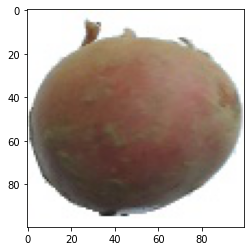

Correct class for image Potato Red 
Predicted class for image Cherry Rainier 


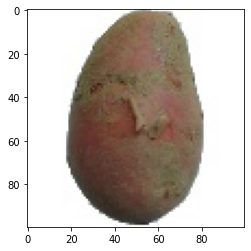

Correct class for image Potato Red 
Predicted class for image Cantaloupe 2 


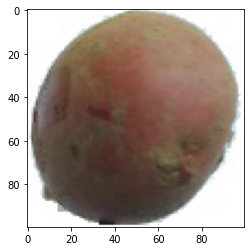

Correct class for image Potato Sweet 
Predicted class for image Cauliflower 


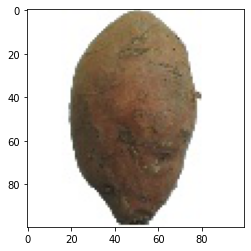

Correct class for image Potato Sweet 
Predicted class for image Cantaloupe 2 


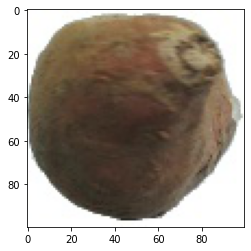

Correct class for image Potato Sweet 
Predicted class for image Carambula 


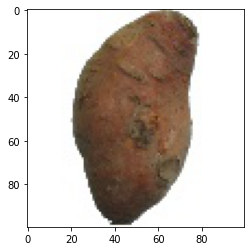

Correct class for image Potato Sweet 
Predicted class for image Cantaloupe 2 


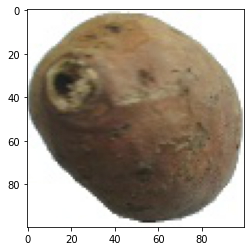

Correct class for image Potato White 
Predicted class for image Carambula 


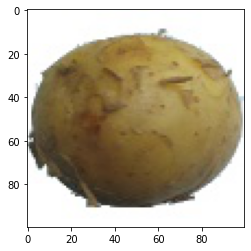

Correct class for image Potato White 
Predicted class for image Carambula 


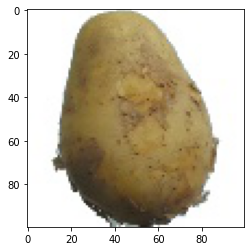

Correct class for image Potato White 
Predicted class for image Carambula 


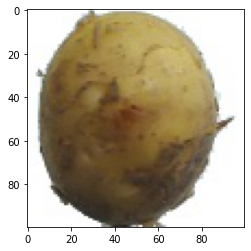

Correct class for image Potato White 
Predicted class for image Carambula 


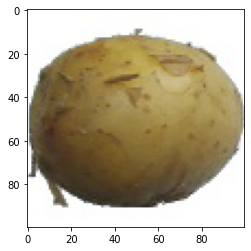

Correct class for image Quince 
Predicted class for image Cantaloupe 1 


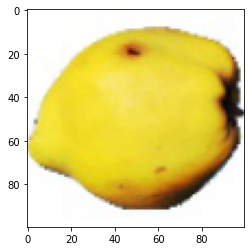

Correct class for image Quince 
Predicted class for image Carambula 


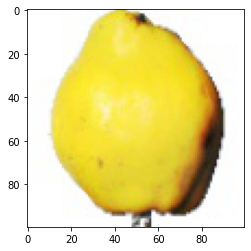

Correct class for image Quince 
Predicted class for image Carambula 


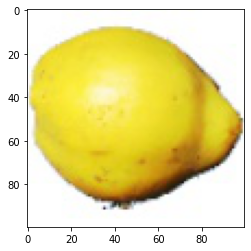

Correct class for image Quince 
Predicted class for image Carambula 


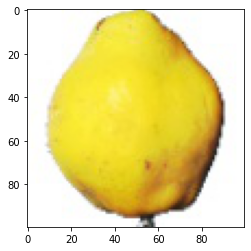

Correct class for image Rambutan 
Predicted class for image Cantaloupe 2 


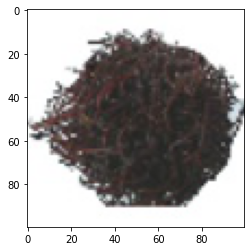

Correct class for image Rambutan 
Predicted class for image Cantaloupe 2 


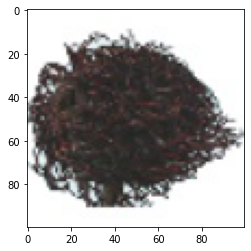

Correct class for image Rambutan 
Predicted class for image Cantaloupe 2 


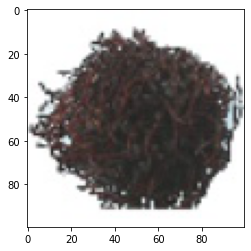

Correct class for image Rambutan 
Predicted class for image Cantaloupe 2 


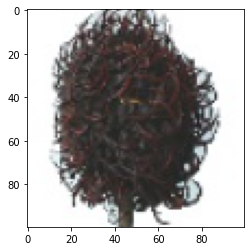

Correct class for image Raspberry 
Predicted class for image Cherry Rainier 


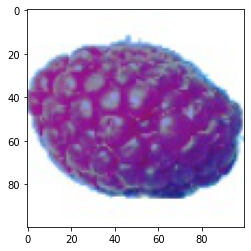

Correct class for image Raspberry 
Predicted class for image Cherry Rainier 


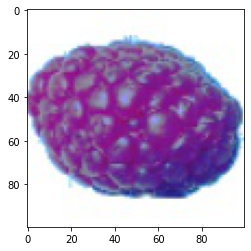

Correct class for image Raspberry 
Predicted class for image Cherry Rainier 


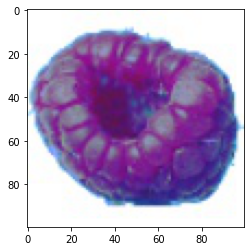

Correct class for image Raspberry 
Predicted class for image Cherry Rainier 


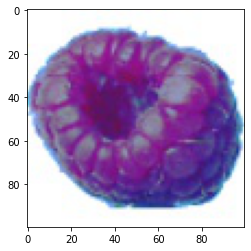

Correct class for image Redcurrant 
Predicted class for image Cherry Rainier 


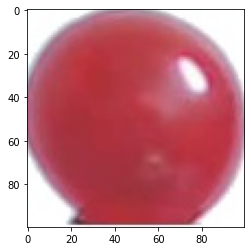

Correct class for image Redcurrant 
Predicted class for image Cherry Rainier 


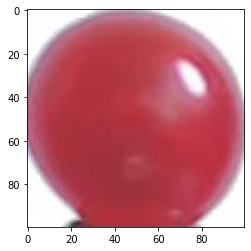

Correct class for image Redcurrant 
Predicted class for image Cherry Rainier 


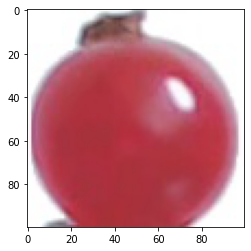

Correct class for image Redcurrant 
Predicted class for image Cherry Rainier 


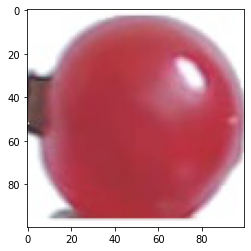

Correct class for image Salak 
Predicted class for image Banana Red 


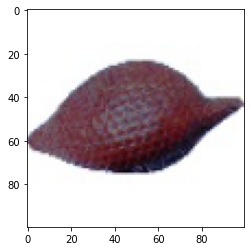

Correct class for image Salak 
Predicted class for image Cherry Rainier 


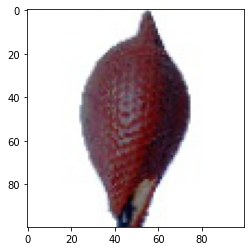

Correct class for image Salak 
Predicted class for image Cherry Rainier 


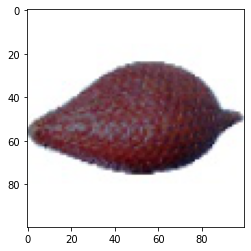

Correct class for image Salak 
Predicted class for image Banana Red 


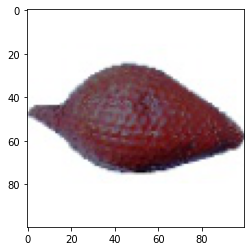

Correct class for image Strawberry Wedge 
Predicted class for image Cherry Rainier 


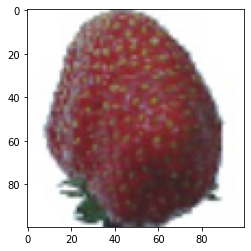

Correct class for image Strawberry Wedge 
Predicted class for image Cherry Rainier 


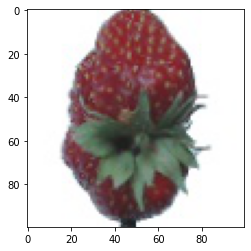

Correct class for image Strawberry Wedge 
Predicted class for image Cherry Rainier 


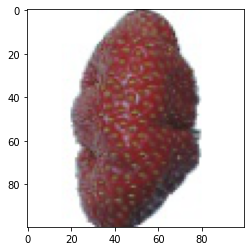

Correct class for image Strawberry Wedge 
Predicted class for image Cantaloupe 2 


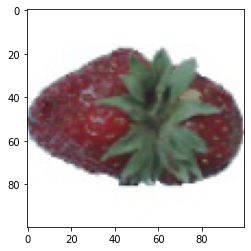

Correct class for image Strawberry 
Predicted class for image Granadilla 


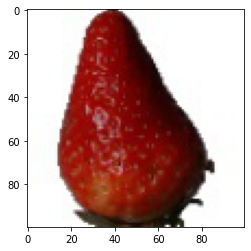

Correct class for image Strawberry 
Predicted class for image Granadilla 


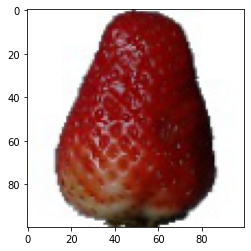

Correct class for image Strawberry 
Predicted class for image Granadilla 


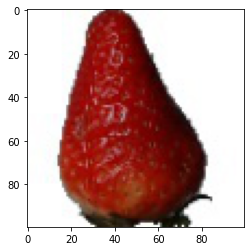

Correct class for image Strawberry 
Predicted class for image Granadilla 


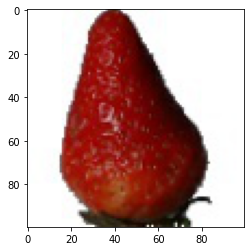

Correct class for image Tamarillo 
Predicted class for image Granadilla 


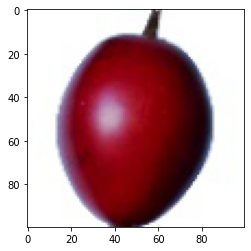

Correct class for image Tamarillo 
Predicted class for image Apple Red 1 


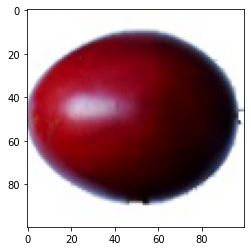

Correct class for image Tamarillo 
Predicted class for image Apple Red 1 


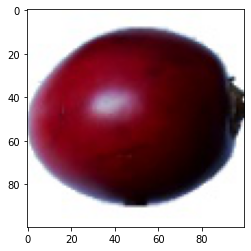

Correct class for image Tamarillo 
Predicted class for image Granadilla 


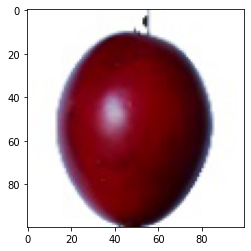

Correct class for image Tangelo 
Predicted class for image Clementine 


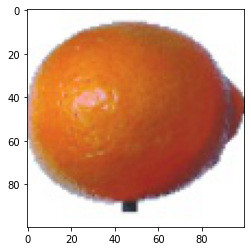

Correct class for image Tangelo 
Predicted class for image Clementine 


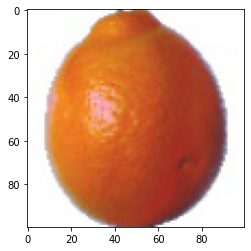

Correct class for image Tangelo 
Predicted class for image Clementine 


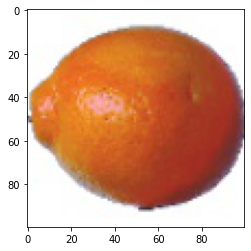

Correct class for image Tangelo 
Predicted class for image Clementine 


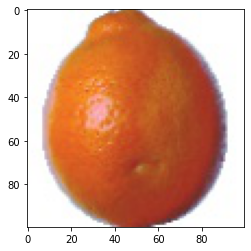

Correct class for image Tomato 1 
Predicted class for image Clementine 


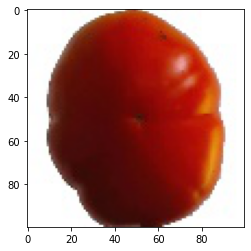

Correct class for image Tomato 1 
Predicted class for image Clementine 


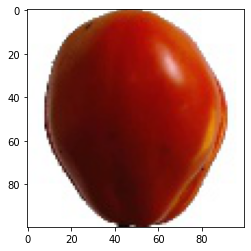

Correct class for image Tomato 1 
Predicted class for image Clementine 


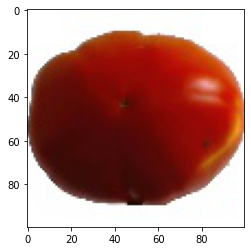

Correct class for image Tomato 1 
Predicted class for image Clementine 


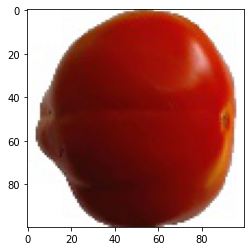

Correct class for image Tomato 2 
Predicted class for image Cherry Rainier 


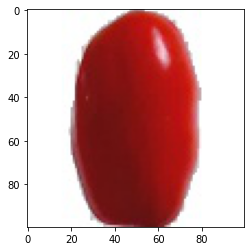

Correct class for image Tomato 2 
Predicted class for image Granadilla 


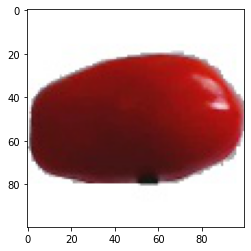

Correct class for image Tomato 2 
Predicted class for image Apple Red Yellow 1 


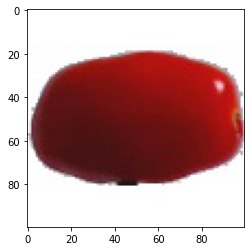

Correct class for image Tomato 2 
Predicted class for image Cherry Rainier 


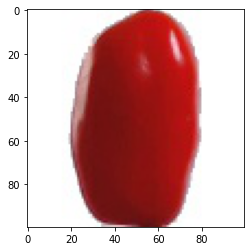

Correct class for image Tomato 3 
Predicted class for image Apple Red Yellow 1 


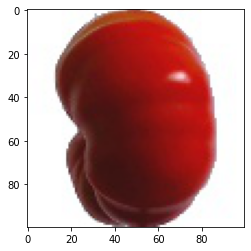

Correct class for image Tomato 3 
Predicted class for image Apple Red Yellow 1 


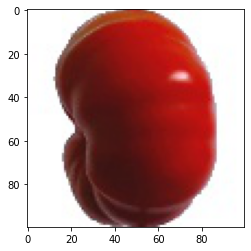

Correct class for image Tomato 3 
Predicted class for image Cherry Wax Yellow 


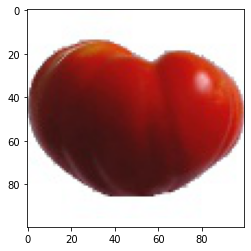

Correct class for image Tomato 3 
Predicted class for image Clementine 


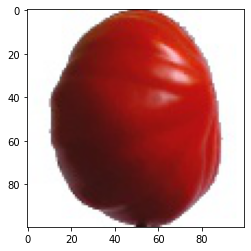

Correct class for image Tomato 4 
Predicted class for image Clementine 


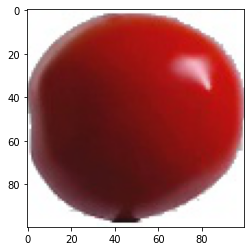

Correct class for image Tomato 4 
Predicted class for image Clementine 


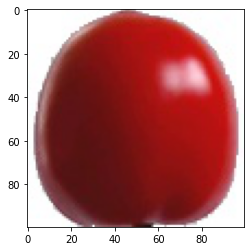

Correct class for image Tomato 4 
Predicted class for image Clementine 


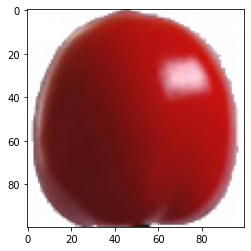

Correct class for image Tomato 4 
Predicted class for image Clementine 


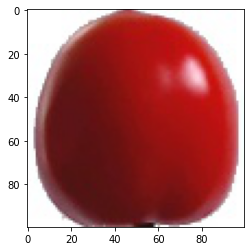

Correct class for image Tomato Cherry Red 
Predicted class for image Clementine 


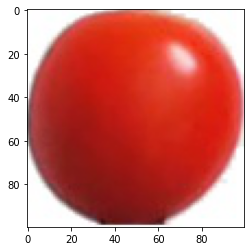

Correct class for image Tomato Cherry Red 
Predicted class for image Clementine 


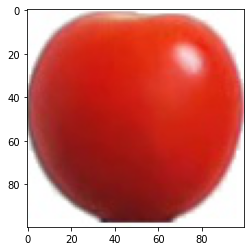

Correct class for image Tomato Cherry Red 
Predicted class for image Clementine 


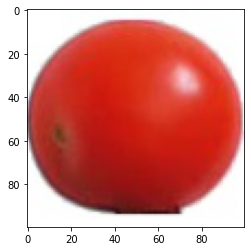

Correct class for image Tomato Cherry Red 
Predicted class for image Clementine 


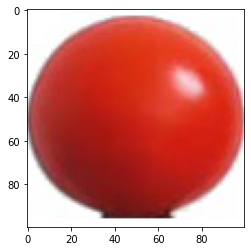

Correct class for image Tomato Heart 
Predicted class for image Clementine 


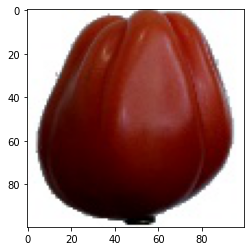

Correct class for image Tomato Heart 
Predicted class for image Clementine 


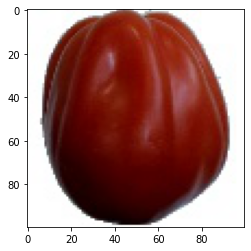

Correct class for image Tomato Heart 
Predicted class for image Clementine 


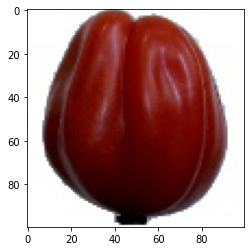

Correct class for image Tomato Heart 
Predicted class for image Clementine 


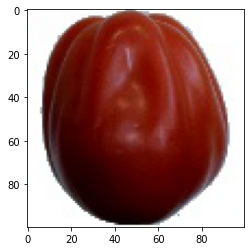

Correct class for image Tomato Maroon 
Predicted class for image Cherry Rainier 


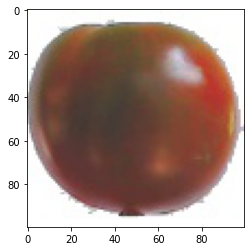

Correct class for image Tomato Maroon 
Predicted class for image Apple Red Yellow 1 


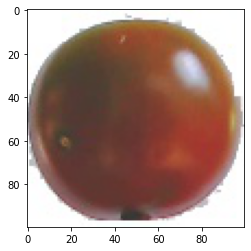

Correct class for image Tomato Maroon 
Predicted class for image Apple Red Yellow 1 


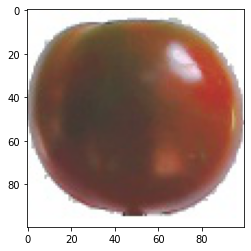

Correct class for image Tomato Maroon 
Predicted class for image Cantaloupe 1 


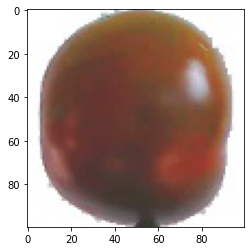

Correct class for image Tomato Yellow 
Predicted class for image Clementine 


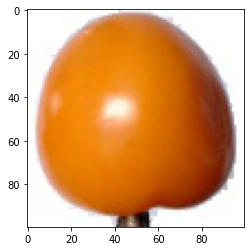

Correct class for image Tomato Yellow 
Predicted class for image Clementine 


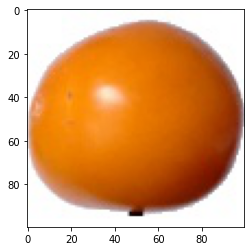

Correct class for image Tomato Yellow 
Predicted class for image Clementine 


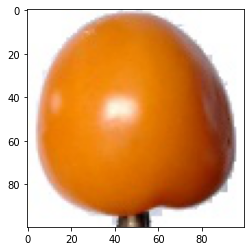

Correct class for image Tomato Yellow 
Predicted class for image Clementine 


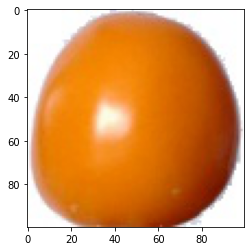

Correct class for image Tomato not Ripened 
Predicted class for image Cauliflower 


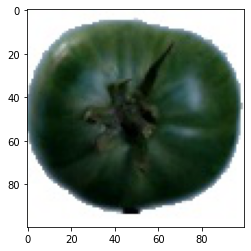

Correct class for image Tomato not Ripened 
Predicted class for image Cauliflower 


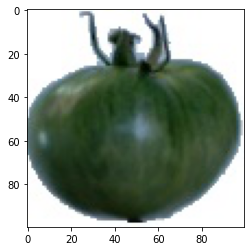

Correct class for image Tomato not Ripened 
Predicted class for image Cauliflower 


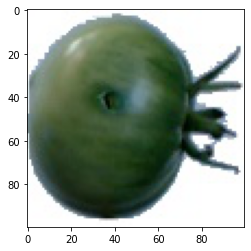

Correct class for image Tomato not Ripened 
Predicted class for image Cauliflower 


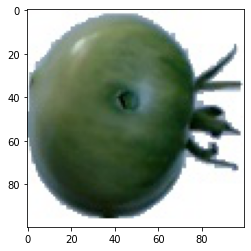

Correct class for image Walnut 
Predicted class for image Cantaloupe 2 


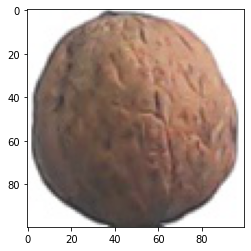

Correct class for image Walnut 
Predicted class for image Cantaloupe 2 


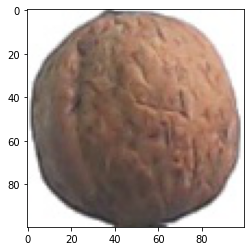

Correct class for image Walnut 
Predicted class for image Cantaloupe 2 


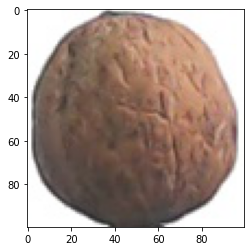

Correct class for image Walnut 
Predicted class for image Cantaloupe 2 


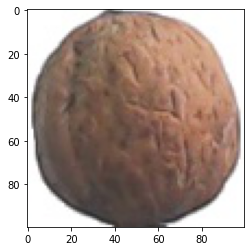

Correct class for image Watermelon 
Predicted class for image Cauliflower 


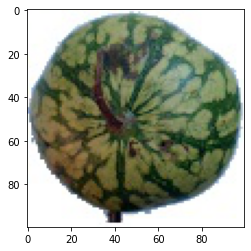

Correct class for image Watermelon 
Predicted class for image Cauliflower 


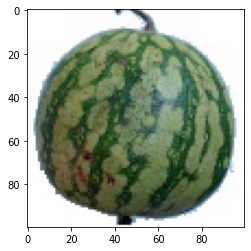

Correct class for image Watermelon 
Predicted class for image Cauliflower 


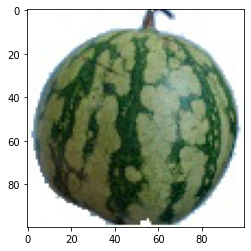

Correct class for image Watermelon 
Predicted class for image Cauliflower 


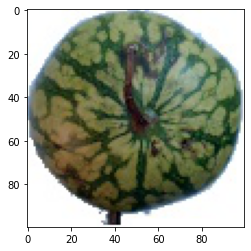

In [53]:
testing_path = '/content/drive/My Drive/fruits_database/fruits-360_dataset/fruits-360/Test'

for i in os.listdir(testing_path):
  for j in os.listdir(os.path.join(testing_path,i))[:4]:
    my_image=load_img(os.path.join(testing_path,i,j))
    x=np.expand_dims(my_image.resize((260,260)),axis=0)
    y=model.predict(x)
    y_class= y.argmax()
    plt.imshow(my_image)
    print('Correct class for image {} '.format(i))
    print('Predicted class for image {} '.format(list(training_label.class_indices.keys())[y_class]))
    plt.show()

In [50]:
list(training_label.class_indices.keys())[y.argmax()]

'Cauliflower'

In [48]:
y.argmax()

25

In [45]:
x.shape

(1, 260, 260, 3)

In [46]:
y

array([[0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0.]], dtype=float32)

In [16]:
training_label.class_indices

{'Apple Braeburn': 0,
 'Apple Crimson Snow': 1,
 'Apple Golden 1': 2,
 'Apple Golden 2': 3,
 'Apple Golden 3': 4,
 'Apple Granny Smith': 5,
 'Apple Pink Lady': 6,
 'Apple Red 1': 7,
 'Apple Red 2': 8,
 'Apple Red 3': 9,
 'Apple Red Delicious': 10,
 'Apple Red Yellow 1': 11,
 'Apple Red Yellow 2': 12,
 'Apricot': 13,
 'Avocado': 14,
 'Avocado ripe': 15,
 'Banana': 16,
 'Banana Lady Finger': 17,
 'Banana Red': 18,
 'Beetroot': 19,
 'Blueberry': 20,
 'Cactus fruit': 21,
 'Cantaloupe 1': 22,
 'Cantaloupe 2': 23,
 'Carambula': 24,
 'Cauliflower': 25,
 'Cherry 1': 26,
 'Cherry 2': 27,
 'Cherry Rainier': 28,
 'Cherry Wax Black': 29,
 'Cherry Wax Red': 30,
 'Cherry Wax Yellow': 31,
 'Chestnut': 32,
 'Clementine': 33,
 'Cocos': 34,
 'Corn': 35,
 'Corn Husk': 36,
 'Cucumber Ripe': 37,
 'Cucumber Ripe 2': 38,
 'Dates': 39,
 'Eggplant': 40,
 'Fig': 41,
 'Ginger Root': 42,
 'Granadilla': 43,
 'Grape Blue': 44,
 'Grape Pink': 45,
 'Grape White': 46,
 'Grape White 2': 47,
 'Grape White 3': 48,
 'Grap

In [ ]:
testing_label.class_indices

{'Apple Braeburn': 0,
 'Apple Crimson Snow': 1,
 'Apple Golden 1': 2,
 'Apple Golden 2': 3,
 'Apple Golden 3': 4,
 'Apple Granny Smith': 5,
 'Apple Pink Lady': 6,
 'Apple Red 1': 7,
 'Apple Red 2': 8,
 'Apple Red 3': 9,
 'Apple Red Delicious': 10,
 'Apple Red Yellow 1': 11,
 'Apple Red Yellow 2': 12,
 'Apricot': 13,
 'Avocado': 14,
 'Avocado ripe': 15,
 'Banana': 16,
 'Banana Lady Finger': 17,
 'Banana Red': 18,
 'Beetroot': 19,
 'Blueberry': 20,
 'Cactus fruit': 21,
 'Cantaloupe 1': 22,
 'Cantaloupe 2': 23,
 'Carambula': 24,
 'Cauliflower': 25,
 'Cherry 1': 26,
 'Cherry 2': 27,
 'Cherry Rainier': 28,
 'Cherry Wax Black': 29,
 'Cherry Wax Red': 30,
 'Cherry Wax Yellow': 31,
 'Chestnut': 32,
 'Clementine': 33,
 'Cocos': 34,
 'Corn': 35,
 'Corn Husk': 36,
 'Cucumber Ripe': 37,
 'Cucumber Ripe 2': 38,
 'Dates': 39,
 'Eggplant': 40,
 'Fig': 41,
 'Ginger Root': 42,
 'Granadilla': 43,
 'Grape Blue': 44,
 'Grape Pink': 45,
 'Grape White': 46,
 'Grape White 2': 47,
 'Grape White 3': 48,
 'Grap